In [1]:
import torch
print("CUDA Available: ", torch.cuda.is_available())
print("Number of GPUs: ", torch.cuda.device_count())

CUDA Available:  True
Number of GPUs:  1


In [2]:
import sys
import os
import anndata
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns

In [3]:
import torch
import torch.distributed as dist
from torch.nn.parallel import DistributedDataParallel as DDP

In [4]:
adata = sc.read_h5ad('/hpc/mydata/siyu.he/squidward_study/data_for_run/adata_norm.h5ad')

In [5]:
adata.obs['group'].unique()

['Rad', 'Rad&Drug', 'Control']
Categories (3, object): ['Control', 'Rad', 'Rad&Drug']

In [6]:
adata.obs['group_new'] = adata.obs['group'].map({'Rad':'Control', 'Rad&Drug':'Rad','Control':'Rad&Drug'})

In [7]:
adata = adata[adata.obs['Major_type']!='HSC-like']

In [8]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=50)
sc.tl.umap(adata,min_dist=0.8)

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:314: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm["X_pca"] = X_pca


EC1
EC2
EC3
EC4
EC5
EC6
Fibroblast1
Fibroblast2
Fibroblast3
Fibroblast4
Fibroblast5
Fibroblast6
Fibroblast7
HSC-like
Mural1
Mural2
Mural3
Mural4
Mural5
Mural6
Mural7
Mural8
Mural9


(-7.477762007713318, 19.8670695066452, -3.360150170326233, 16.76847107410431)

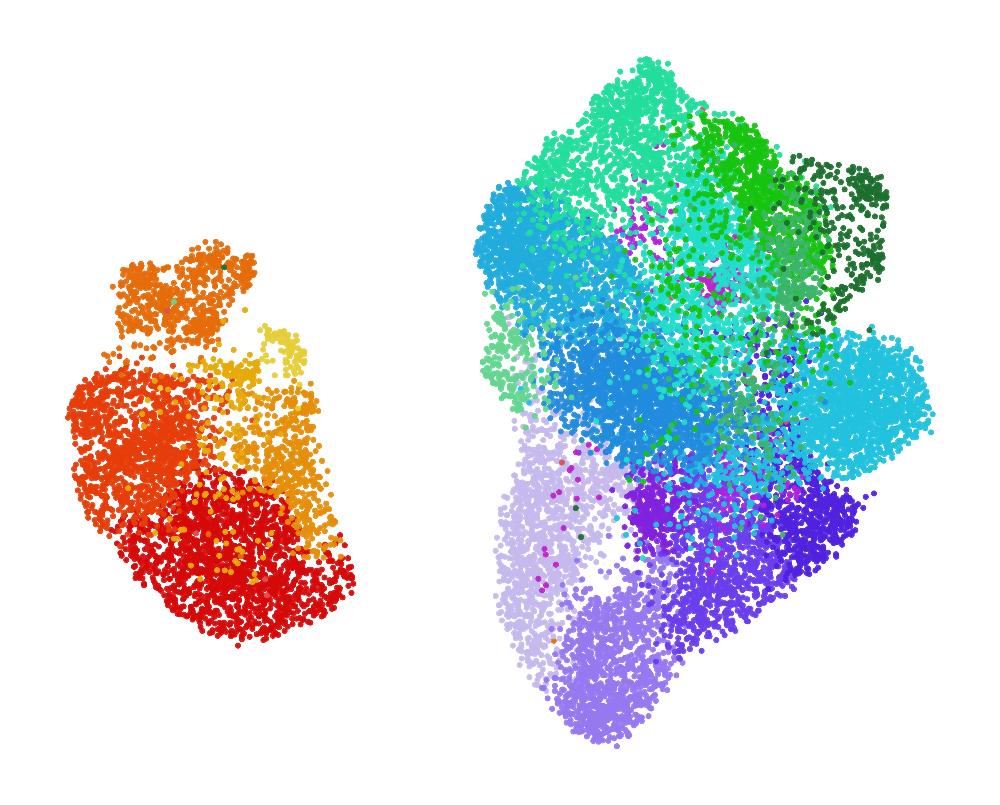

In [9]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors  = ['#d60909', # EC1
               '#e63d09', # EC2
               '#e66c09', # EC3
               '#e68e09', # EC4
               '#e6ab09', # EC5
               '#e6ce37', # EC6
               '#c6b9ed', # Fibroblast1, 
               '#9678f0', # Fibroblast2, 
               '#6a3eed', # Fibroblast3, 
               '#5021de', # Fibroblast4,
               '#8021de', # Fibroblast5, 
               '#af21de', # Fibroblast6, 
               '#c122c9', # Fibroblast7, 
               '#e34f4f', # HSC
               '#21c2de', # Mural1 
               '#21acde', # Mural2
               '#218cde', # Mural3
               '#21de9c', # Mural4
               '#21decb', # Mural5
               '#16c410', # Mural6 
               '#3cb56c', # Mural7
               '#1c702d', # Mural8
               '#63d690' # Mural9 
              ]
# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(5,4),dpi=800)
for (j,i) in enumerate(np.unique(adata.obs['Minor_type'])):
    print(i)
    g=axs.scatter(adata.obsm['X_umap'][adata.obs['Minor_type']==i, 0], 
                  adata.obsm['X_umap'][adata.obs['Minor_type']==i, 1], 
                  color=hex_colors[j], 
                  alpha=0.9,s=0.6, 
                 )
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

(-7.477762007713318, 19.8670695066452, -3.360150170326233, 16.76847107410431)

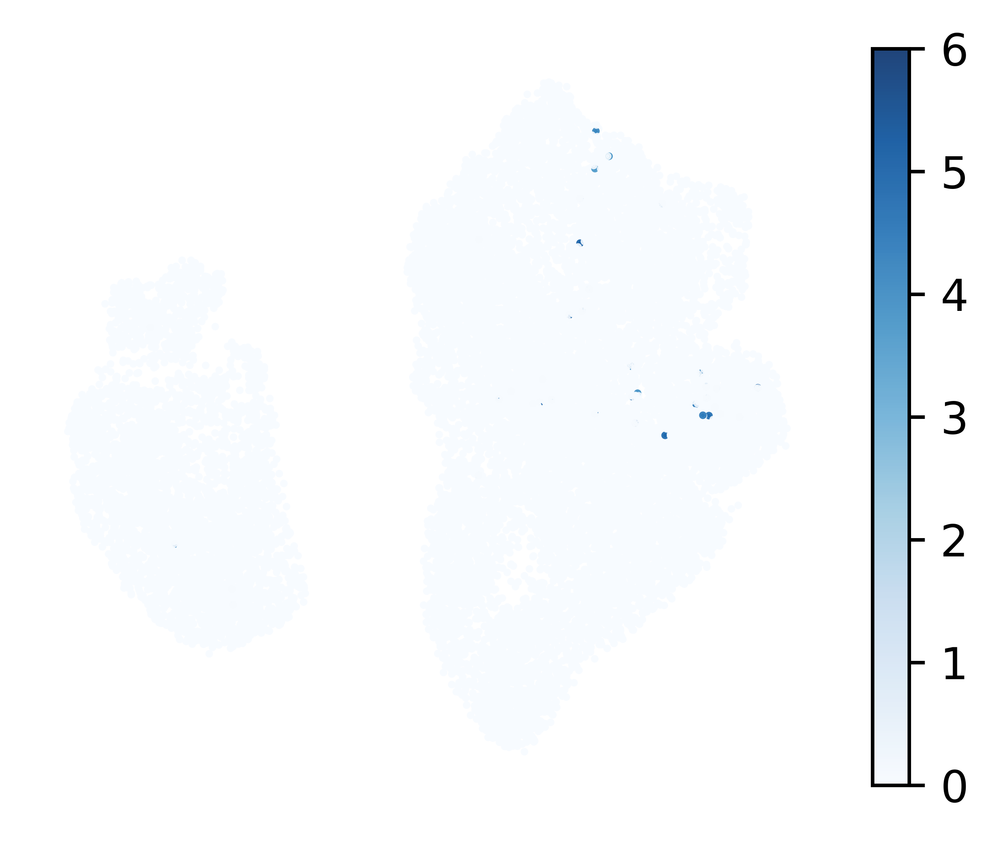

In [11]:
fig, axs = plt.subplots(1,1,figsize=(4,3),dpi=800)
g = axs.scatter(adata.obsm['X_umap'][:, 0], 
            adata.obsm['X_umap'][:, 1], 
            c=adata[:,'PTPRC'].to_df().values, 
            alpha=0.9,s=0.5, 
            cmap = 'Blues',
            vmin=0,
            vmax=6
         )
plt.colorbar(g)
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [28]:
sc.tl.paga(adata, groups="Minor_type")
#sc.tl.draw_graph(adata_ctl)
sc.pl.paga(adata, 
           color=["Minor_type"],
           edge_width_scale=0.2, 
           frameon = False, 
           fontsize = 0,
           cmap = rgb_colors
)
fig = plt.subplots(figsize =(3.6, 1.2),dpi=500)
for i in range(22):    
    plt.scatter(i,1,c=hex_colors[i],marker='s',s=50)
plt.axis('off')

In [9]:
#sc.pp.highly_variable_genes(adata, n_top_genes=500)
#BMP_signaling = ["AHSG","BAMBI","BMP2","BMP4","BMP6","BMP7","BMPR1A","BMPR1B","BMPR2","CER1","CHRD","CHRDL1","CTDSP1","CTDSP2","CTDSPL","FST","GREM1","GSK3B","HJV","MAP3K7","MAPK1","NOG","NUP214","PPM1A","PPP1CA","PPP1R15A","RGMA","RGMB","SKI","SMAD1","SMAD4","SMAD5","SMAD6","SMAD7","SMAD9","SMURF1","SMURF2","SOSTDC1","TAB1","TAB2","XIAP","ZFYVE16"]
others  = ['NANOG','T','GATA6','POU5F1','HAND1','MKI67',
           'ETV2','CLDN5','PECAM1','SOX17','COL4A1','DCN',
           'ACTA2','PDGFRB','FOXA2','EOMES','MIXL1','COL5A1',
           'CXCR4','NR2F2','GJA4','PGF','RGS16','ADAMTS18'
          ]
adata.var.highly_variable  = False
others = list(sc.read_h5ad('/hpc/mydata/siyu.he/squidward_study/results/fig4/interp_all_ann.h5ad').var_names)

for i in others:
    adata.var.highly_variable[i]=True

/tmp/ipykernel_3231821/4227479897.py:12: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable[i]=True
/tmp/ipykernel_3231821/4227479897.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

In [454]:
'VEGFA' in adata.var_names

False

In [11]:
adata = adata[:, adata.var.highly_variable]

In [12]:
adata

View of AnnData object with n_obs × n_vars = 18989 × 596
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type', 'group_new'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

## subsampling to normal VO first

In [13]:
adata.obs['group'].unique()

['Rad', 'Rad&Drug', 'Control']
Categories (3, object): ['Control', 'Rad', 'Rad&Drug']

In [15]:
adata_ctl_rad = adata[adata.obs['group_new'].isin(['Control','Rad'])].copy()
adata_ctl_rad

AnnData object with n_obs × n_vars = 13151 × 596
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type', 'group_new'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [16]:
temp_ = adata_ctl_rad.obs[['group_new','Major_type']]

In [17]:
del adata_ctl_rad.var
del adata_ctl_rad.obsm
del adata_ctl_rad.obs
adata_ctl_rad.obs = temp_

In [18]:
sc.tl.pca(adata_ctl_rad, svd_solver='arpack')
sc.pp.neighbors(adata_ctl_rad, n_neighbors=30, n_pcs=50)
sc.tl.umap(adata_ctl_rad,min_dist=0.5)

In [19]:
adata_ctl_rad.obs['group_major_type'] = [i+'_'+j for (i,j) in zip(adata_ctl_rad.obs['group_new'],adata_ctl_rad.obs['Major_type'])]

Control_EC
Control_Fibroblast
Control_Mural
Rad_EC
Rad_Fibroblast
Rad_Mural


(-5.236329579353333, 15.775158905982972, -3.91706862449646, 13.057248258590699)

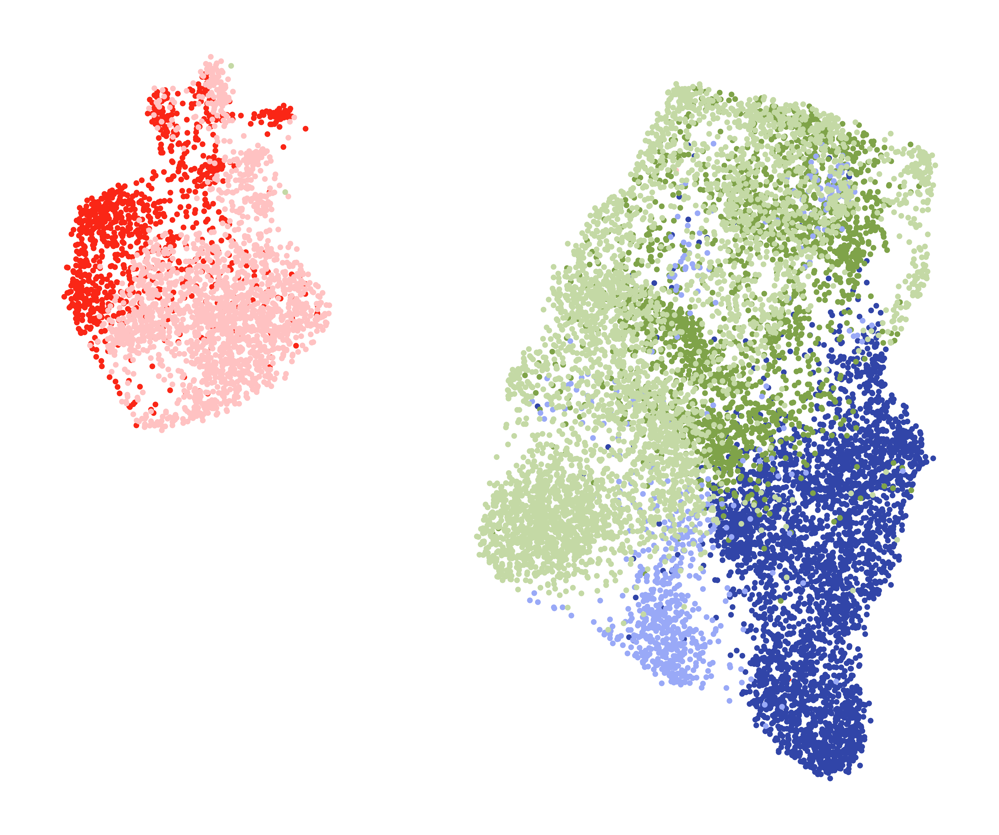

In [20]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = [ '#fa2616','#3145a8','#7fa349', 
              '#ffc2c2','#99a9f7','#c4d9a5',]

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(6,5),dpi=800)
for i in np.unique(adata_ctl_rad.obs['group_major_type']):
    print(i)
    g=axs.scatter(adata_ctl_rad.obsm['X_umap'][adata_ctl_rad.obs['group_major_type']==i, 0], 
                  adata_ctl_rad.obsm['X_umap'][adata_ctl_rad.obs['group_major_type']==i, 1], 
                  color=rgb_colors[list(np.unique(adata_ctl_rad.obs['group_major_type'])).index(i)], 
                  alpha=1,s=1, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [21]:
adata_ctl_rad.obs['train']= '-1'
adata_ctl_rad.obs['train'][adata_ctl_rad.obs['Major_type']=='EC']= '1'
#adata_ctl_rad.obs['train'][(adata_ctl_rad.obs['Major_type']!='EC')&(adata_ctl_rad.obs['group']=='Control')]= '1'

/tmp/ipykernel_3231821/1243133431.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_ctl_rad.obs['train'][adata_ctl_rad.obs['Major_type']=='EC']= '1'
/tmp/ipykernel_3231821/1243133431.py:2: SettingWithCopyWarning: 
A value is trying t

-1
1


(-5.236329579353333, 15.775158905982972, -3.91706862449646, 13.057248258590699)

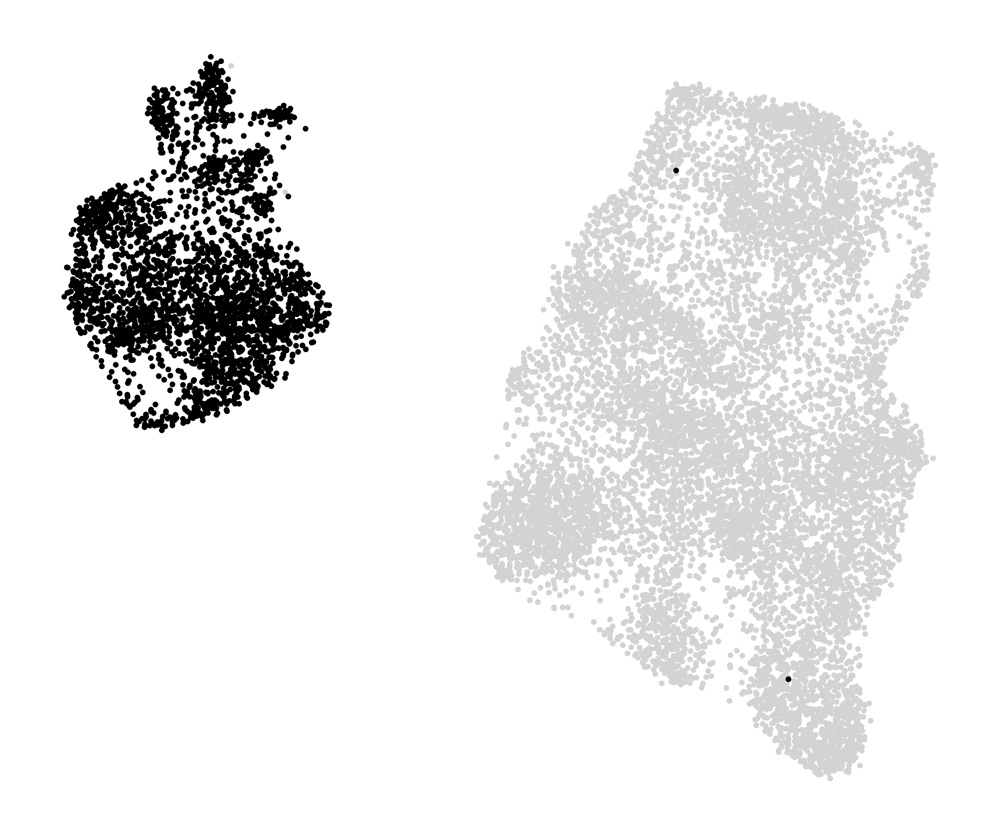

In [22]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors = [ 'lightgray','k']

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(6,5),dpi=800)
for i in np.unique(adata_ctl_rad.obs['train']):
    print(i)
    g=axs.scatter(adata_ctl_rad.obsm['X_umap'][adata_ctl_rad.obs['train']==i, 0], 
                  adata_ctl_rad.obsm['X_umap'][adata_ctl_rad.obs['train']==i, 1], 
                  color=rgb_colors[list(np.unique(adata_ctl_rad.obs['train'])).index(i)], 
                  alpha=1,s=1, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

## if I only trained control and EC with rad, explore how it look like

In [23]:
trained_adata = adata_ctl_rad[
    (adata_ctl_rad.obs['Major_type']=='EC')# |
   # ((adata_ctl_rad.obs['Major_type']!='EC')&(adata_ctl_rad.obs['group']=='Control'))
].copy()

In [25]:
np.unique([i+'_'+j for (i,j) in zip(trained_adata.obs['Major_type'],trained_adata.obs['group_new'])]
         )

array(['EC_Control', 'EC_Rad'], dtype='<U10')

In [27]:
trained_adata.obs['group_new'] = trained_adata.obs['group_new'].map({'Control':0,
                                                             'Rad':1
                             })

trained_adata.obs['Major_type'] = trained_adata.obs['Major_type'].map({'EC':1,
                                                                       'Fibroblast':2,
                                                                       'Mural':3,
                                                                       'HSC-like':4
                             })
trained_adata.obs['Major_type']  = trained_adata.obs['Major_type'].astype(int).astype('category')
trained_adata.obs['group_new']  = trained_adata.obs['group_new'].astype(int).astype('category')


In [28]:
del trained_adata.obs['group_major_type']

In [29]:
del trained_adata.obs['train']

In [30]:
trained_adata.write('/hpc/mydata/siyu.he/squidward_study/data_for_run/VO_rad_trained_adata_wdiff.h5ad')


In [31]:
trained_adata

AnnData object with n_obs × n_vars = 2935 × 596
    obs: 'group_new', 'Major_type'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [32]:
import matplotlib
from matplotlib import rcParams
import sys
import os

import pandas as pd
import scanpy as sc
import numpy as np
import warnings

import torch
import torch.nn.functional as F
import torch.nn as nn

from torch.utils.data import DataLoader, TensorDataset

import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns
import matplotlib.font_manager
from matplotlib import rcParams

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2

import io
import os
import socket

import torch as th
import torch.distributed as dist
import argparse

from Squidiff import dist_util,logger

from Squidiff.scrna_datasets import load_VO_rad_data,prepared_data
from Squidiff.resample import create_named_schedule_sampler
from Squidiff.script_util import (
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    args_to_dict,
    add_dict_to_argparser,
)

from Squidiff.train_util import TrainLoop

GPUS_PER_NODE = 1 

In [33]:

def get_default_args():
    defaults = dict(
        data_dir="",
        schedule_sampler="uniform",
        lr=1e-4,
        weight_decay=0.0,
        lr_anneal_steps=0,
        batch_size=64,
        microbatch=-1,  # -1 disables microbatches
        ema_rate="0.9999",  # comma-separated list of EMA values
        log_interval=5000,
        save_interval=10000,
        resume_checkpoint="",
        use_fp16=False,
        fp16_scale_growth=1e-3,
        use_encoder=False
    )
    defaults.update(model_and_diffusion_defaults())
    return defaults



def setup_dist():
    """
    Setup a distributed process group.
    """
    if dist.is_initialized():
        return
    backend = "gloo" if not th.cuda.is_available() else "nccl"
    dist.init_process_group(backend=backend, init_method="env://")


def dev():
    """
    Get the device to use for torch.distributed.
    """
    if th.cuda.is_available():
        return th.device(f"cuda")
    return th.device("cpu")


def load_state_dict(path, **kwargs):
    """
    Load a PyTorch file without redundant fetches across ranks.
    """
    chunk_size = 2 ** 30  # Size limit for data chunks
    if dist.get_rank() == 0:
        with open(path, "rb") as f:
            data = f.read()
        num_chunks = len(data) // chunk_size
        if len(data) % chunk_size:
            num_chunks += 1
        dist.broadcast(th.tensor(num_chunks), 0)
        for i in range(0, len(data), chunk_size):
            dist.broadcast(th.tensor(data[i: i + chunk_size]), 0)
    else:
        num_chunks = dist.broadcast(th.tensor(0), 0).item()
        data = bytes()
        for _ in range(num_chunks):
            chunk = th.zeros(chunk_size, dtype=th.uint8)
            dist.broadcast(chunk, 0)
            data += bytes(chunk.numpy())

    return th.load(io.BytesIO(data), **kwargs)


def sync_params(params):
    """
    Synchronize a sequence of Tensors across ranks from rank 0.
    """
    for p in params:
        with th.no_grad():
            dist.broadcast(p, 0)


def _find_free_port():
    """
    Find a free port for distributed training setup.
    """
    try:
        s = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
        s.bind(("", 0))
        s.setsockopt(socket.SOL_SOCKET, socket.SO_REUSEADDR, 1)
        return s.getsockname()[1]
    finally:
        s.close()


def run_training(args):

    logger.configure(dir='/hpc/mydata/siyu.he/squidward_study/logger_file')

    logger.log("creating model and diffusion...")
    model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )
    model.to(dev())
    schedule_sampler = create_named_schedule_sampler(args['schedule_sampler'], diffusion)

    logger.log("creating data loader...")
    data = prepared_data(
        
        data_dir=args['data_dir'],
        fn = load_VO_rad_data
    )

    logger.log("training...")
    train_ = TrainLoop(
        model=model,
        diffusion=diffusion,
        data=data,
        batch_size=args['batch_size'],
        microbatch=args['microbatch'],
        lr=args['lr'],
        ema_rate=args['ema_rate'],
        log_interval=args['log_interval'],
        save_interval=args['save_interval'],
        resume_checkpoint=args['resume_checkpoint'],
        use_fp16=args['use_fp16'],
        fp16_scale_growth=args['fp16_scale_growth'],
        schedule_sampler=schedule_sampler,
        weight_decay=args['weight_decay'],
        lr_anneal_steps=args['lr_anneal_steps'],
    )
    train_.run_loop()
    return train_.loss_list


args = get_default_args()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 3e5,
    'batch_size': 128,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 5000,
    'save_interval': 1e4,#1e4,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 596, 
    'output_dim':596,
    'num_layers':3,
    'class_cond': False,  
    'use_encoder': True,
})


losses = run_training(args)

Logging to /hpc/mydata/siyu.he/squidward_study/logger_file
creating model and diffusion...
creating data loader...
training...
-------------------------
| grad_norm  | 1.15     |
| loss       | 1.11     |
| loss_q0    | 1.12     |
| loss_q1    | 1.09     |
| loss_q2    | 1.13     |
| loss_q3    | 1.12     |
| mse        | 1.11     |
| mse_q0     | 1.12     |
| mse_q1     | 1.09     |
| mse_q2     | 1.13     |
| mse_q3     | 1.12     |
| param_norm | 172      |
| samples    | 128      |
| step       | 0        |
-------------------------
saving model 0...
saving model 0.9999...
-------------------------
| grad_norm  | 0.654    |
| loss       | 0.483    |
| loss_q0    | 0.857    |
| loss_q1    | 0.469    |
| loss_q2    | 0.309    |
| loss_q3    | 0.296    |
| mse        | 0.483    |
| mse_q0     | 0.857    |
| mse_q1     | 0.469    |
| mse_q2     | 0.309    |
| mse_q3     | 0.296    |
| param_norm | 175      |
| samples    | 6.4e+05  |
| step       | 5e+03    |
-------------------------


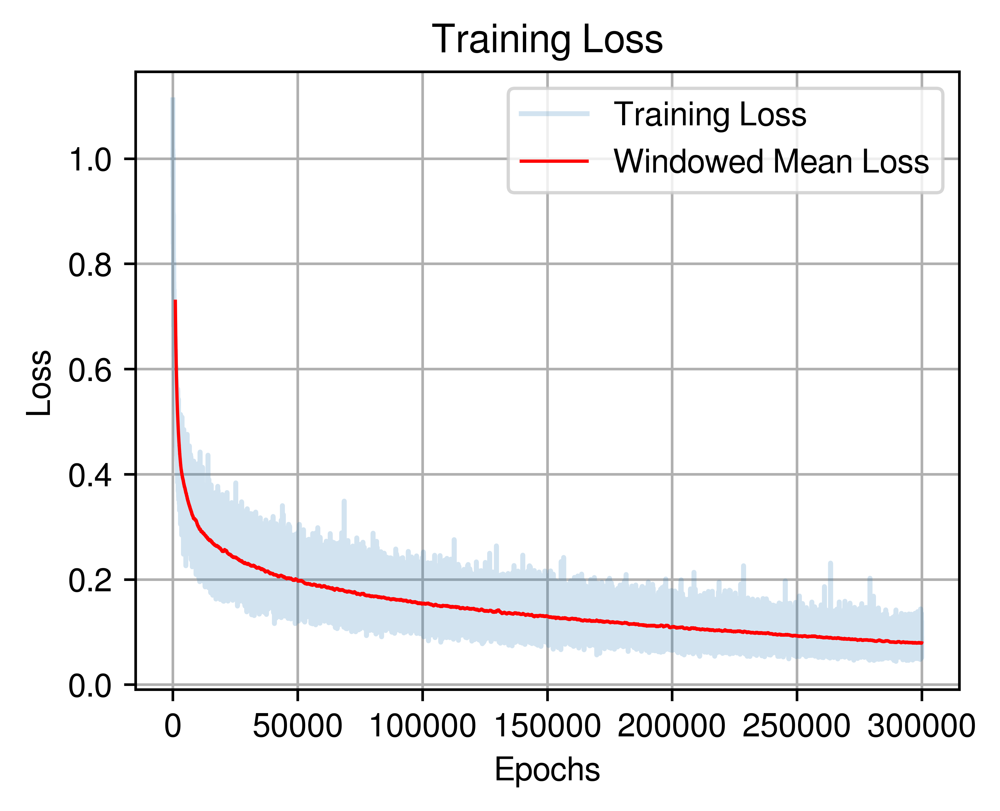

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Convert losses to a numpy array
losses_np = np.array([i.detach().cpu().numpy() for i in losses])

# Define the window size for the moving average
window_size = 1000  # You can adjust this value based on your preference

# Calculate the moving average (mean of the windowed losses)
windowed_mean_loss = np.convolve(losses_np, np.ones(window_size) / window_size, mode='valid')

# Adjust the x-axis values for the windowed mean loss
x_vals = np.linspace(0, len(losses_np), len(losses_np))
windowed_x_vals = x_vals[window_size - 1:]  # Adjust to match the length of the windowed_mean_loss

# Plotting
plt.figure(figsize=(4.5, 3.4), dpi=800)
plt.plot(x_vals, losses_np, label='Training Loss', alpha=0.2)
plt.plot(windowed_x_vals, windowed_mean_loss, label='Windowed Mean Loss', color='r', linewidth=1)

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()
plt.grid(True)
plt.show()


In [35]:
import argparse
import os

import numpy as np
import torch as th
import torch.distributed as dist

from Squidiff import dist_util, logger
from Squidiff.script_util import (
    NUM_CLASSES,
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    add_dict_to_argparser,
    args_to_dict,
)


def create_argparser():
    defaults = dict(
        clip_denoised=False,
        num_samples=2400,
        batch_size=16,
        use_ddim=False,
        model_path="model.pt",
    )
    defaults.update(model_and_diffusion_defaults())

    return defaults


In [36]:
args = create_argparser()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 2400,
    'batch_size': 16,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 50,
    'save_interval': 1000,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 596, 
    'output_dim':596,
    'num_layers':3,
    'class_cond': False,  
    'use_ddim':True,
    'use_encoder':True,
    
})
#dist_util.setup_dist()

logger.configure(dir='logger_file')
logger.log("creating model and diffusion...")

model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )

model.load_state_dict(
    dist_util.load_state_dict(args['model_path'])
)
model.to(dist_util.dev())
if args['use_fp16']:
    model.convert_to_fp16()
model.eval()


Logging to logger_file
creating model and diffusion...


MLPModel(
  (encoder): EncoderMLPModel(
    (fc1): Linear(in_features=596, out_features=2048, bias=True)
    (bn1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (fc2): Linear(in_features=2048, out_features=2048, bias=True)
    (fc3): Linear(in_features=2048, out_features=60, bias=True)
    (label_embed): Linear(in_features=1, out_features=2048, bias=True)
  )
  (time_embed): Sequential(
    (0): Linear(in_features=2048, out_features=2048, bias=True)
    (1): SiLU()
    (2): Linear(in_features=2048, out_features=2048, bias=True)
  )
  (mlp_blocks): TimestepEmbedSequential(
    (0): MLPBlock(
      (fc1): Linear(in_features=2048, out_features=2048, bias=True)
      (fc2): Linear(in_features=2048, out_features=2048, bias=True)
      (layer_norm1): LayerNorm((2048,), eps=1e-05, elementwise_affine=True)
      (layer_norm2): LayerNorm((2048,), eps=1e-05, eleme

In [37]:
from Squidiff.scrna_datasets import load_gene_pert_data,prepared_data
import torch
data = load_VO_rad_data(data_dir=args['data_dir'])

In [38]:
def stochastic_encode(
    model, x, t, model_kwargs):
    """
    ddim reverse sample
    """
    sample = x
    sample_t = []
    xstart_t = []
    T = []
    indices = list(range(t))

    for i in indices:
        timestep = torch.full((x.shape[0],), i, device='cuda').long()
        with torch.no_grad():
            out = diffusion.ddim_reverse_sample(model, 
                                                sample, 
                                                timestep, 
                                                model_kwargs=model_kwargs)
            sample = out['sample']
            sample_t.append(sample)
            xstart_t.append(out['pred_xstart'])
            T.append(timestep)

    return {
    'sample': sample,
    'sample_t': sample_t,
    'xstart_t': xstart_t,
    'T': T,
}


In [39]:
z_sem = model.encoder(torch.tensor(data[0].X.toarray()).to('cuda'),
                      #label = torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
                     )

model_kwargs = {'x_start':torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }

x_T = stochastic_encode(model,
                  x = torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']


In [40]:
label = data[0].obs.values[:,0]

In [41]:
import umap
def plot_embed(x_,n_neighbors=50, min_dist=0.01, n_components=2, random_state=42,s=5):

    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=random_state)
    embedding = reducer.fit_transform(x_.detach().cpu())
    plt.figure(figsize=(5,5), dpi=800)
    #hex_colors = [ '#fa2616','#3145a8','#7fa349', 
    #          '#ffc2c2','#99a9f7','#c4d9a5',]

    colorlist = ['#fa2616', '#ffc2c2','#654597','#7FB069']  # Colors for day 0 and day 3
    plt.scatter(embedding[label==0, 0], 
            embedding[label==0, 1], 
            c=colorlist[0],
            s=s,
            alpha=1)
    plt.scatter(embedding[label==1, 0], 
                embedding[label==1, 1], 
                c=colorlist[1],
                s=s,
                alpha=1)
    
    plt.scatter(embedding[label==2, 0], 
                embedding[label==2, 1], 
                c=colorlist[2],
                s=s,
                alpha=1)
    plt.scatter(embedding[label==3, 0], 
                embedding[label==3, 1], 
                c=colorlist[3],
                s=s,
                alpha=1)
    
    plt.axis('off')
    plt.show()

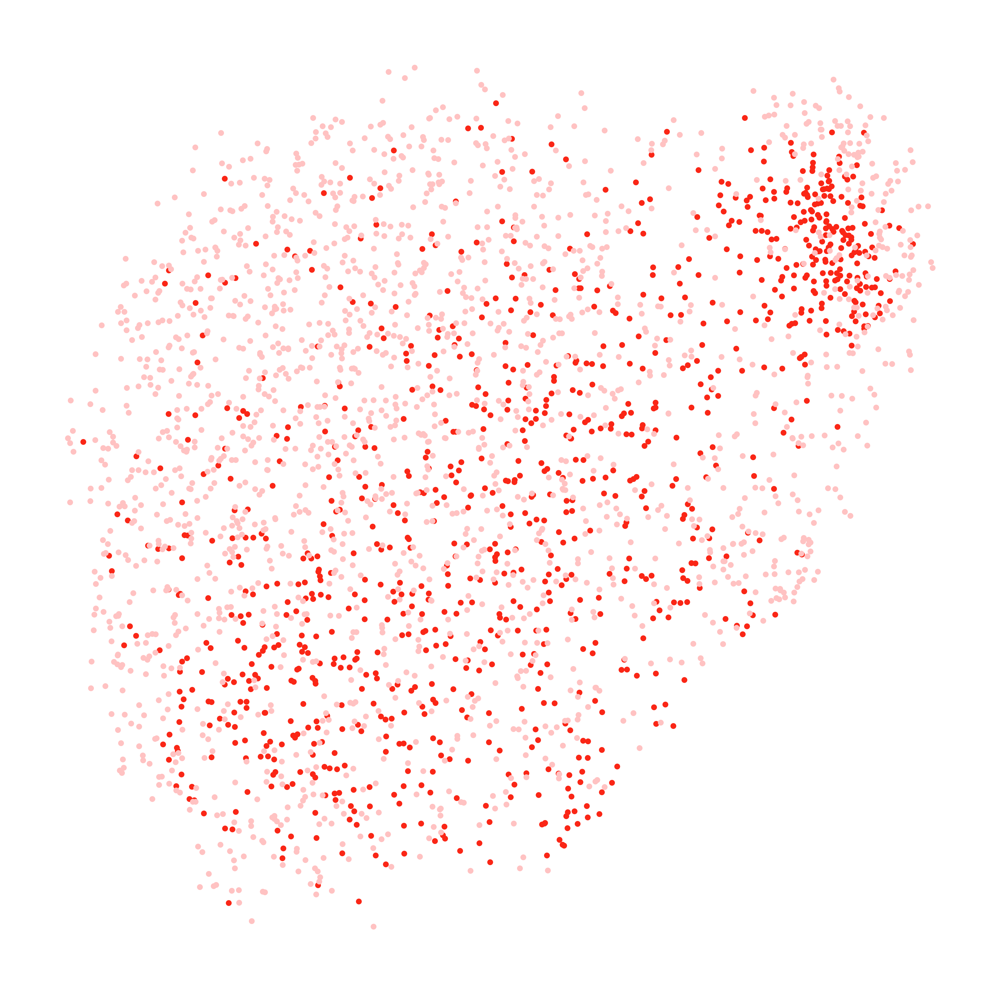

In [42]:
plot_embed(z_sem,s=0.5)

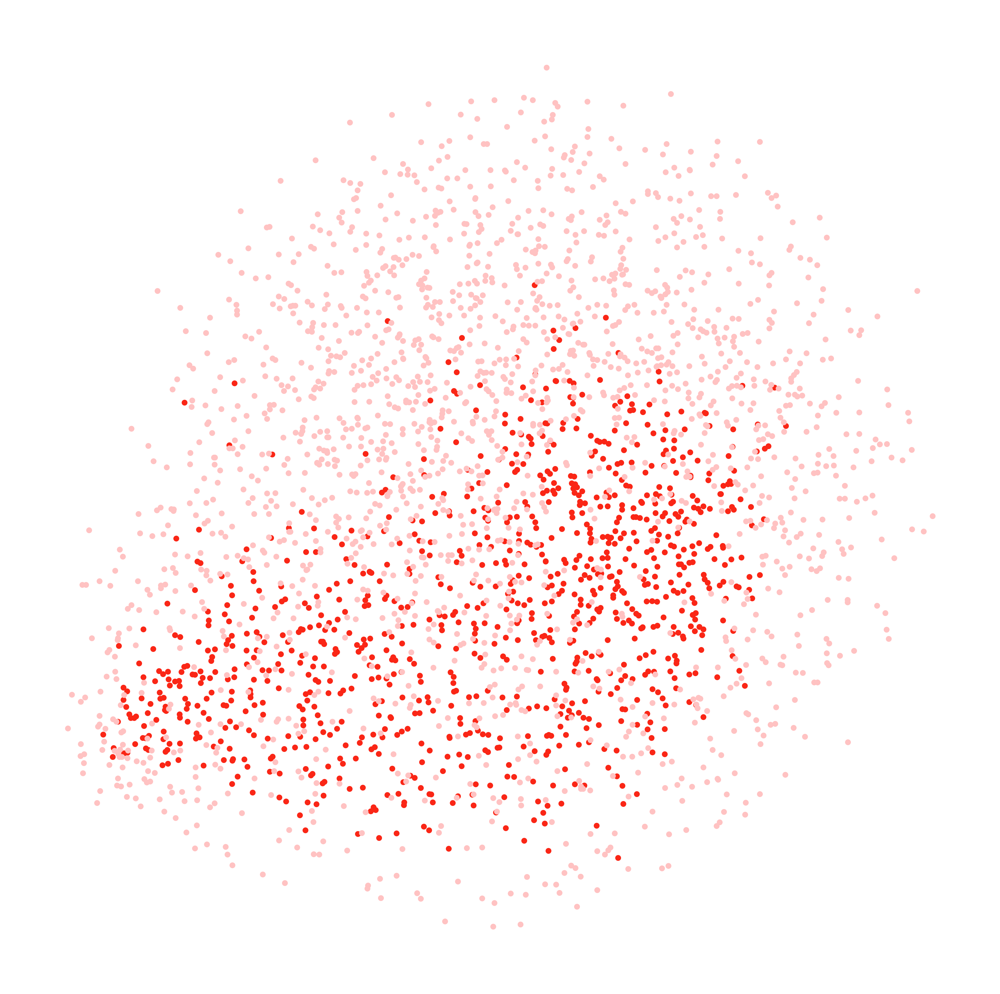

In [43]:
plot_embed(x_T,s=0.5)

In [44]:
logger.log("sampling...")
sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)


sample_interp0 = sample_fn(
                    model,
                    shape = (len(z_sem), args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': z_sem},
                    noise =  None
)

sampling...


In [45]:
from scipy.stats import gaussian_kde
def display_reconst(df_true,
                    df_pred,
                    density=False,
                    den_all = False,
                    marker_genes=None,
                    sample_rate=0.1,
                    size=(4, 4),
                    spot_size=1,
                    title=None,
                    x_label='',
                    y_label='',
                    ):
    """
    Scatter plot - raw gexp vs. reconstructed gexp
    """
    assert 0 < sample_rate <= 1, \
        "Invalid downsampling rate for reconstruct scatter plot: {}".format(sample_rate)

    if marker_genes is not None:
        marker_genes = set(marker_genes)

    df_true_sample = df_true.sample(frac=sample_rate, random_state=0)
    df_pred_sample = df_pred.loc[df_true_sample.index]

    plt.rcParams["figure.figsize"] = size
    plt.figure(dpi=800)
    ax = plt.gca()

    xx = df_true_sample.T.to_numpy().flatten()
    yy = df_pred_sample.T.to_numpy().flatten()

    if density and not den_all:
        for gene in df_true_sample.columns:
            try:
                gene_true = df_true_sample[gene].values
                gene_pred = df_pred_sample[gene].values
                gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

                z = gaussian_kde(gexp_stacked)(gexp_stacked)
                ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
            except np.linalg.LinAlgError as e:
                pass

    elif marker_genes is not None:
        color_dict = {True: 'red', False: 'green'}
        gene_colors = np.vectorize(
            lambda x: color_dict[x in marker_genes]
        )(df_true_sample.columns)
        colors = np.repeat(gene_colors, df_true_sample.shape[0])

        ax.scatter(xx, yy, c=colors, s=spot_size, alpha=0.5)

    elif density and den_all:
        gene_true = df_true_sample.values.flatten()
        gene_pred = df_pred_sample.values.flatten()
        gexp_stacked = np.vstack([df_true_sample.values.flatten(), df_pred_sample.values.flatten()])
        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
    else:
        ax.scatter(xx, yy, s=spot_size, alpha=0.5)
    
    min_val = min(xx.min(), yy.min())
    max_val = max(xx.max(), yy.max())
    #ax.set_xlim(min_val, 400)
    
    #ax.set_ylim(min_val, 400)
    ax.set_aspect('equal',adjustable='box')
    ax.axis('equal')
    ax.set_xlim(0, 20)
    ax.set_ylim(0, 20)
    plt.suptitle(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)

    plt.show()

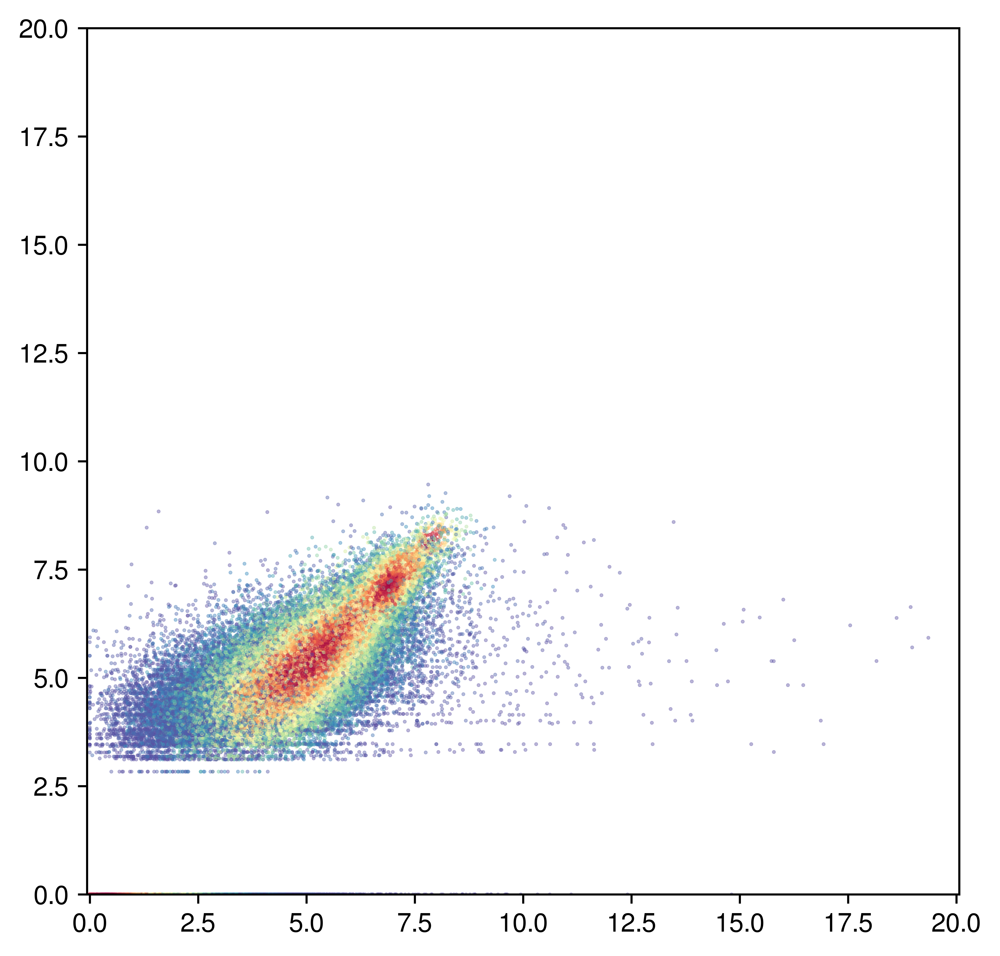

In [46]:

display_reconst(pd.DataFrame(sample_interp0.detach().cpu() ), 
                pd.DataFrame(data[0].X.toarray()),
                density=True,
                size=(6,6),
                spot_size=0.2,
                #den_all=True,
               )

In [48]:
torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray(), dtype = torch.float32).to('cuda').shape

torch.Size([952, 596])

In [49]:

direct_z_sem = z_sem[data[0].obs.values[:,0]==1].mean(axis=0) - z_sem[data[0].obs.values[:,0]==0].mean(axis=0)
direct_xT = x_T[data[0].obs.values[:,0]==1].mean(axis=0) - x_T[data[0].obs.values[:,0]==0].mean(axis=0)


z_sem_FB = model.encoder(torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray()).to('cuda'))
model_kwargs = {'x_start':torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem_FB,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }
x_T_FB = stochastic_encode(model,
                  x = torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Fibroblast')].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']

z_sem_mural = model.encoder(torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray()).to('cuda'))
model_kwargs = {'x_start':torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem_mural,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }
x_T_mural = stochastic_encode(model,
                  x = torch.tensor(adata[(adata.obs['group']=='Control') & (adata.obs['Major_type']=='Mural')].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']


z_sem_FB_rad = z_sem_FB + direct_z_sem
z_sem_mural_rad = z_sem_mural + direct_z_sem

x_T_FB_rad = x_T_FB + direct_xT
x_T_mural_rad = x_T_mural + direct_xT


sample_interp_FB_rad = sample_fn(
                            model,
                            shape = (len(z_sem_FB_rad), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_FB_rad, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_FB_rad
        )

sample_interp_mural_rad = sample_fn(
                            model,
                            shape = (len(z_sem_mural_rad), args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_mural_rad, dtype = torch.float32).to('cuda') 
                            },
                            noise =  x_T_mural_rad
        )

In [56]:
sample_interp_FB_rad.detach().cpu().shape

torch.Size([952, 596])

In [62]:
import scipy
from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
        np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Fibroblast')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )

r_= r2_score(
np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Fibroblast')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )
print(p_)
print(r_)

0.9829483432176747
0.9501978754997253


(-0.2, 10.0)

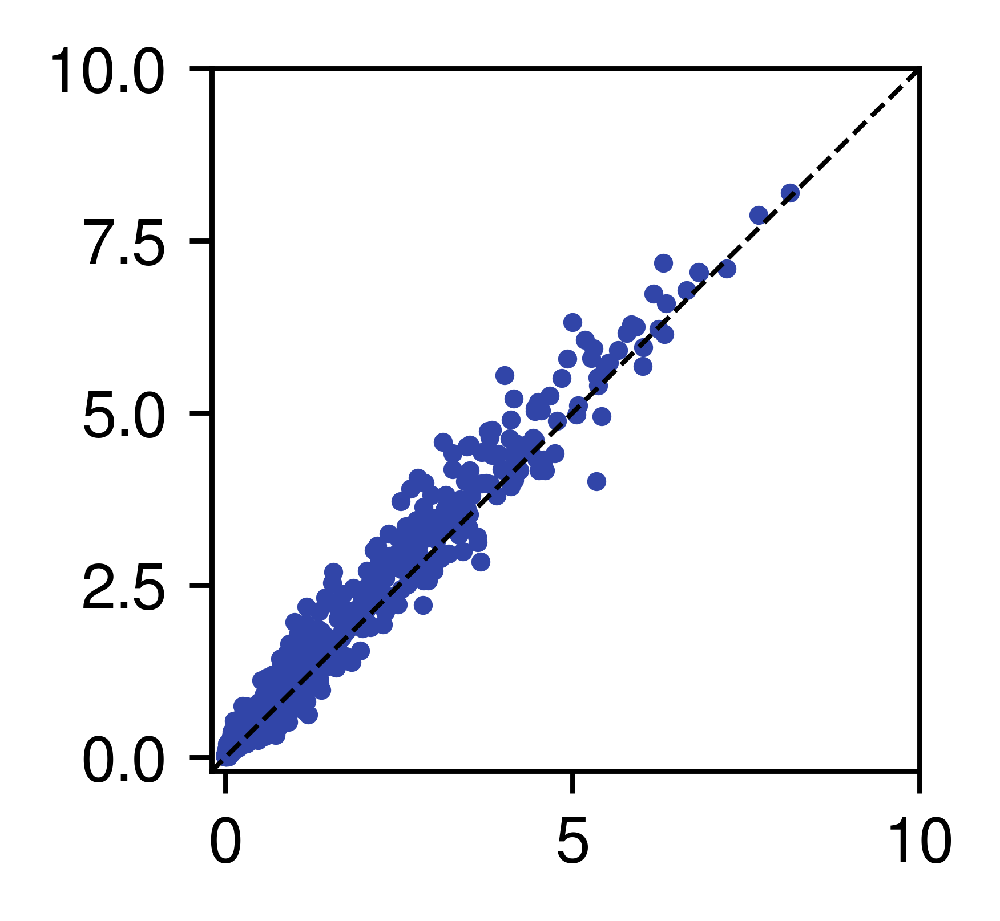

In [60]:
    #hex_colors = [ '#fa2616','#3145a8','#7fa349', 
    #          '#ffc2c2','#99a9f7','#c4d9a5',]

plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Fibroblast')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0),
            s=4,
            c='#3145a8'
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

(-0.2, 10.0)

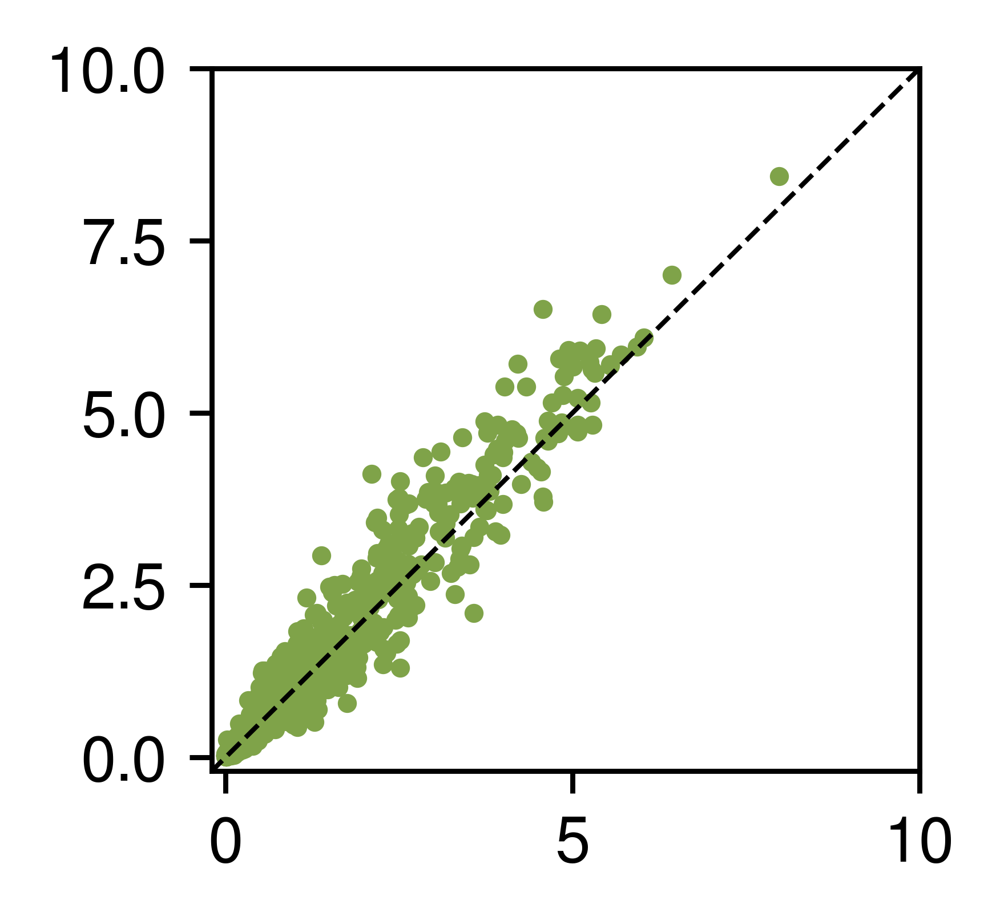

In [64]:
plt.subplots(1,1,figsize=(2,2),dpi=800)
plt.scatter(np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Mural')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
            s=4,
            c='#7fa349'
           )
plt.plot(np.linspace(-1,15,100),
         np.linspace(-1,15,100),
         '--',
         color='k',
         linewidth = 0.75,
        )
plt.xlim([-0.2,10])
plt.ylim([-0.2,10])

In [65]:
import scipy
from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Mural')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
                                )

r_= r2_score(
np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Mural')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
            sample_interp_mural_rad.detach().cpu().numpy().mean(axis=0),
                                )
print(p_)
print(r_)

0.9626005231192456
0.9055323600769043


In [66]:
import scipy
from sklearn.metrics import r2_score
p_ , _ = scipy.stats.pearsonr(
        np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Fibroblast')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )

r_= r2_score(
np.array(adata_ctl_rad[(adata_ctl_rad.obs['group_new']=='Rad') & (adata_ctl_rad.obs['Major_type']=='Fibroblast')].copy()[:952,:].X.mean(axis=0)).transpose()[:,0],
        sample_interp_FB_rad.detach().cpu().numpy().mean(axis=0)
                    )
print(p_)
print(r_)

0.9829483432176747
0.9501978754997253


In [67]:
sample_interp = anndata.AnnData(torch.concat([sample_interp_FB_rad, 
                                              sample_interp_mural_rad],axis=0).detach().cpu().numpy()
                               )
sample_interp.obs['cell_type'] = ['FB'] * sample_interp_FB_rad.shape[0] + ['Mura'] * sample_interp_mural_rad.shape[0]
sample_interp.write('/hpc/mydata/siyu.he/squidward_study/results/fig5/sample_interp_rad.h5ad')

In [68]:
def pred_VO(data_):
    z_sem_ = model.encoder(torch.tensor(data_.X).to('cuda'))
    model_kwargs = {'x_start':torch.tensor(data_.X, dtype = torch.float32).to('cuda'),
                    'z_mod':z_sem_,
                   }

    x_T_ = stochastic_encode(model,
                      x = torch.tensor(data_.X, dtype = torch.float32).to('cuda'),
                      t = 999,
                      model_kwargs=model_kwargs
                     )['sample']



    z_sem_pertb = z_sem_ + direct_z_sem

    x_T_pertb = x_T_ + direct_xT


    sample_interp_ = sample_fn(
                                model,
                                shape = (len(z_sem_pertb), args['gene_size']),
                                clip_denoised=args['clip_denoised'],
                                model_kwargs={
                                    'z_mod': torch.tensor(z_sem_pertb, dtype = torch.float32).to('cuda') 
                                },
                                noise =  x_T_pertb
            )
    return sample_interp_
    

In [69]:
interp_all_ann = sc.read_h5ad('/hpc/mydata/siyu.he/squidward_study/results/fig4/interp_all_ann.h5ad')
interp_all_ann.obs['label_type'] = [str(i)+'_'+j for (i,j) in zip(interp_all_ann.obs['label'],interp_all_ann.obs['type'])]
interp_all_ann.obs['label_type'].unique()

array(['-1.0_EC', '1.0_EC', '3.0_EC', '5.0_EC', '7.0_EC', '9.0_EC',
       '11.0_EC', '13.0_EC', '15.0_EC', '17.0_EC', '-1.0_Fibroblast',
       '1.0_Fibroblast', '3.0_Fibroblast', '5.0_Fibroblast',
       '7.0_Fibroblast', '9.0_Fibroblast', '11.0_Fibroblast',
       '13.0_Fibroblast', '15.0_Fibroblast', '17.0_Fibroblast',
       '-1.0_Mural', '1.0_Mural', '3.0_Mural', '5.0_Mural', '7.0_Mural',
       '9.0_Mural', '11.0_Mural', '13.0_Mural', '15.0_Mural',
       '17.0_Mural'], dtype=object)

In [70]:
np.intersect1d(interp_all_ann.var_names,adata_ctl_rad.var_names).shape

(596,)

In [74]:
pred_scVO_list = []
pred_label_type_list = []
for i in interp_all_ann.obs['label_type'].unique():
    print(i)
    pred_scVO_list.append(pred_VO(interp_all_ann[interp_all_ann.obs['label_type']==i].copy()))
    pred_label_type_list = pred_label_type_list + [i] * interp_all_ann[interp_all_ann.obs['label_type']==i].copy().shape[0]

-1.0_EC
1.0_EC
3.0_EC
5.0_EC
7.0_EC
9.0_EC
11.0_EC
13.0_EC
15.0_EC
17.0_EC
-1.0_Fibroblast
1.0_Fibroblast
3.0_Fibroblast
5.0_Fibroblast
7.0_Fibroblast
9.0_Fibroblast
11.0_Fibroblast
13.0_Fibroblast
15.0_Fibroblast
17.0_Fibroblast
-1.0_Mural
1.0_Mural
3.0_Mural
5.0_Mural
7.0_Mural
9.0_Mural
11.0_Mural
13.0_Mural
15.0_Mural
17.0_Mural


In [108]:
pred_scVO_anndata = anndata.AnnData(torch.concat(pred_scVO_list,axis=0).detach().cpu().numpy())
pred_scVO_anndata.var_names = interp_all_ann.var_names
pred_scVO_anndata.obs['label'] = pred_label_type_list
pred_scVO_anndata.obs['pertb'] = 'True'

pred_scVO_anndata.obs['day'] = [i.split('_')[0] for i in pred_scVO_anndata.obs['label']]
pred_scVO_anndata.obs['type'] =[i.split('_')[1] for i in pred_scVO_anndata.obs['label']]

In [109]:
pred_scVO_anndata

AnnData object with n_obs × n_vars = 30000 × 596
    obs: 'label', 'pertb', 'day', 'type'

In [371]:
pred_scVO_anndata.write('/hpc/mydata/siyu.he/squidward_study/results/fig4/pred_scVO_anndata_pertb.h5ad')

In [5]:
pred_scVO_anndata = sc.read_h5ad('/hpc/mydata/siyu.he/squidward_study/results/fig4/pred_scVO_anndata_pertb.h5ad')

interp_all_ann = sc.read_h5ad('/hpc/mydata/siyu.he/squidward_study/results/fig4/interp_all_ann.h5ad')


In [10]:
interp_all_ann.obs['pertb'] = 'False'
interp_all_ann.obs['day'] = interp_all_ann.obs['label'].astype(str)



In [11]:
concated_anndata = sc.concat([pred_scVO_anndata,interp_all_ann])
concated_anndata

concated_anndata.obs['type_pertb'] = [i+'_'+j for (i,j) in zip(concated_anndata.obs['type'],concated_anndata.obs['pertb'])]

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [114]:
sc.tl.pca(concated_anndata, svd_solver='arpack')
sc.pp.neighbors(concated_anndata, n_neighbors=50, n_pcs=50)
sc.tl.umap(concated_anndata,min_dist=0.8)

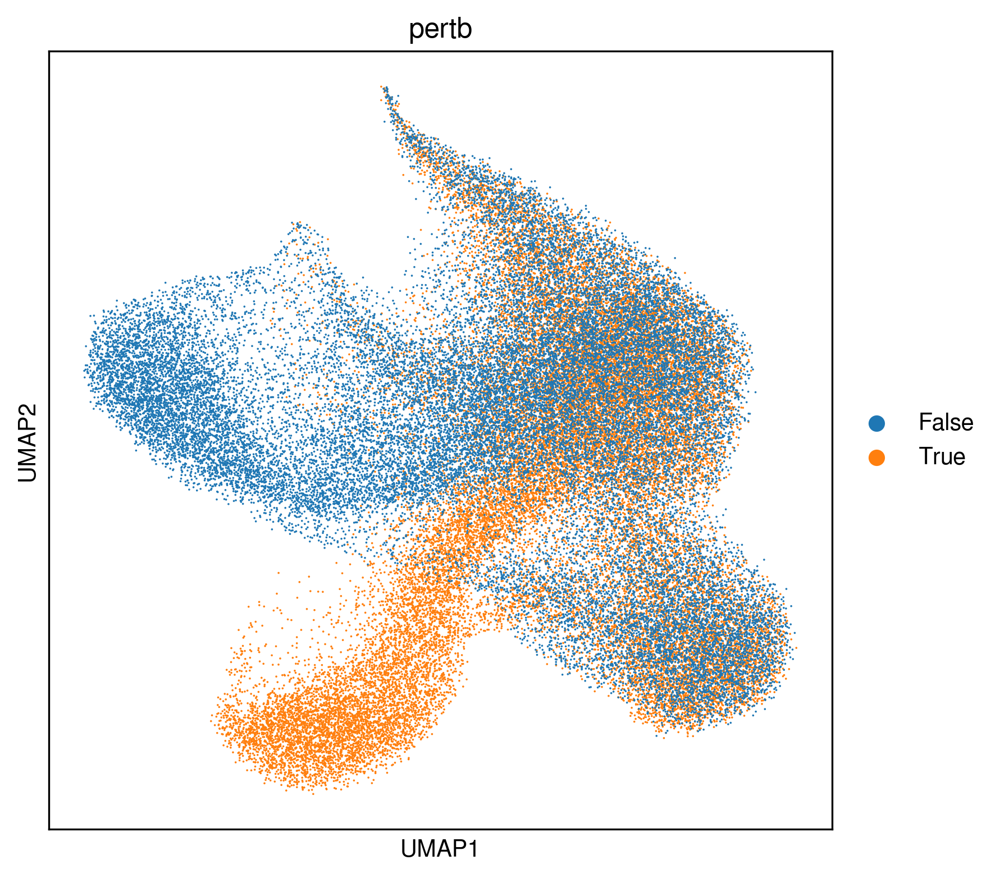

In [115]:
sc.pl.umap(concated_anndata,color = 'pertb',size=3)

In [117]:
concated_anndata.obs

,label,pertb,day,type
0,-1.0_EC,True,-1.0,EC
1,-1.0_EC,True,-1.0,EC
2,-1.0_EC,True,-1.0,EC
3,-1.0_EC,True,-1.0,EC
4,-1.0_EC,True,-1.0,EC
...,...,...,...,...
29995,17.0,False,17.0,Mural
29996,17.0,False,17.0,Mural
29997,17.0,False,17.0,Mural
29998,17.0,False,17.0,Mural


False
True


(-4.798025691509247,
 14.408141934871674,
 -8.724291515350341,
 14.110865306854247)

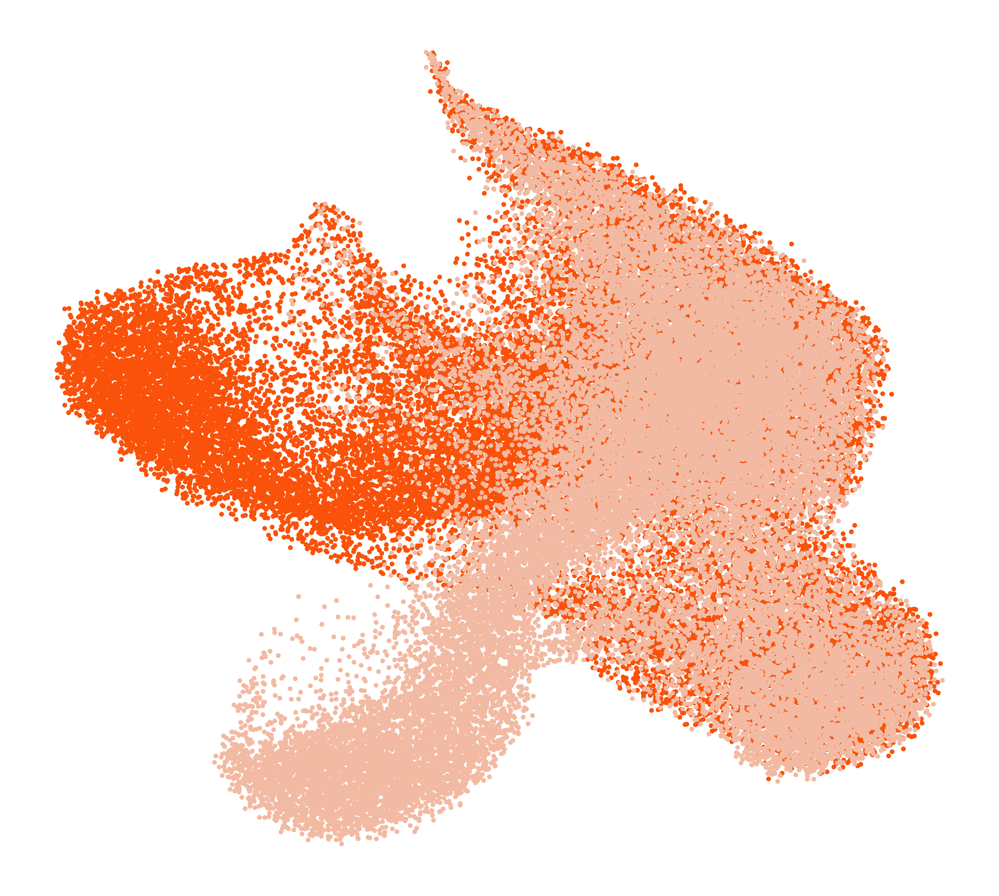

In [128]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
#'#fa460a','#f2b58d',
hex_colors = [  '#fa520a','#f2baa2']
# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

fig, axs = plt.subplots(1,1,figsize=(10,9),dpi=800)
for i in np.unique(concated_anndata.obs['pertb']):
    print(i)
    g=axs.scatter(concated_anndata.obsm['X_umap'][concated_anndata.obs['pertb']==i, 0], 
                  concated_anndata.obsm['X_umap'][concated_anndata.obs['pertb']==i, 1], 
                  color=rgb_colors[list(np.unique(concated_anndata.obs['pertb'])).index(i)], 
                  alpha=1,s=3, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

EC_False
EC_True
Fibroblast_False
Fibroblast_True
Mural_False
Mural_True


(-4.798025691509247,
 14.408141934871674,
 -8.724291515350341,
 14.110865306854247)

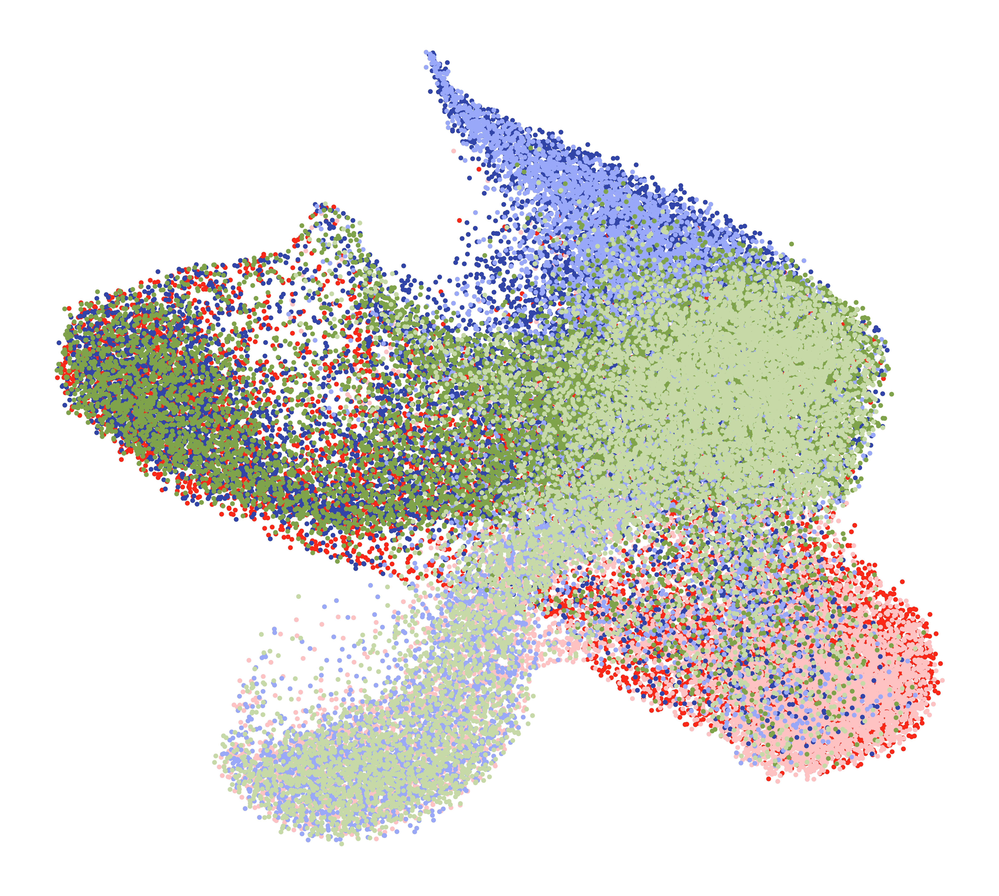

In [119]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
#'#fa460a','#f2b58d',
hex_colors = [  '#fa2616','#ffc2c2','#3145a8','#99a9f7','#7fa349', 
                '#c4d9a5',]
# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)

fig, axs = plt.subplots(1,1,figsize=(10,9),dpi=800)
for i in np.unique(concated_anndata.obs['type_pertb']):
    print(i)
    g=axs.scatter(concated_anndata.obsm['X_umap'][concated_anndata.obs['type_pertb']==i, 0], 
                  concated_anndata.obsm['X_umap'][concated_anndata.obs['type_pertb']==i, 1], 
                  color=rgb_colors[list(np.unique(concated_anndata.obs['type_pertb'])).index(i)], 
                  alpha=1,s=3, 
                  label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [120]:
sc.tl.embedding_density(concated_anndata, groupby="type_pertb")


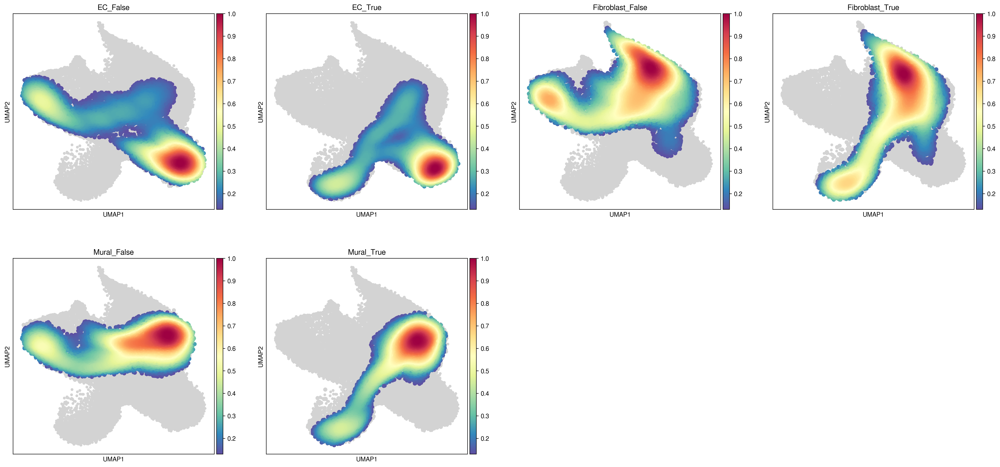

<Figure size 1800x1800 with 0 Axes>

In [121]:
#fig,ax = plt.subplots(figsize=(4,4))
sc.pl.embedding_density(concated_anndata, 
                        groupby="type_pertb", 
                        color_map='Spectral_r', 
                        vmin=0.13,
                        #ax=ax
                       )

fig = plt.gcf()
for ax in fig.get_axes():
    ax.axis('off')

# Display the plot
plt.show()

In [90]:
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt

deg_up_df_EC = pd.DataFrame()
deg_down_df_EC = pd.DataFrame()
deg_up_df_FB = pd.DataFrame()
deg_down_df_FB = pd.DataFrame()
deg_up_df_mural = pd.DataFrame()
deg_down_df_mural = pd.DataFrame()

# Define the filtering criteria
p_value_threshold = 1
logFC_threshold = 0

# Helper function to filter DEGs and include p-values and logFC
def filter_deg(temp, cell_type):
    degs = pd.DataFrame(temp.uns['rank_genes_groups']['names'])
    pvals = pd.DataFrame(temp.uns['rank_genes_groups']['pvals'])
    logfc = pd.DataFrame(temp.uns['rank_genes_groups']['logfoldchanges'])
    
    up_genes = degs[(pvals[cell_type + '_True'] < p_value_threshold) & (logfc[cell_type + '_True'] > logFC_threshold)][[cell_type + '_True']]
    down_genes = degs[(pvals[cell_type + '_True'] < p_value_threshold) & (logfc[cell_type + '_True'] <- logFC_threshold)][[cell_type + '_True']]
    
    up_genes.loc[:,'pvals'] = pvals.loc[up_genes.index,cell_type + '_True']
    up_genes.loc[:,'logFC'] = logfc.loc[up_genes.index,cell_type + '_True']
    
    down_genes.loc[:,'pvals'] = pvals.loc[down_genes.index,cell_type + '_True']
    down_genes.loc[:,'logFC'] = logfc.loc[down_genes.index,cell_type + '_True']
    
    return up_genes, down_genes

# Process endothelial cells
for i in concated_anndata.obs['day'].unique():
    temp = concated_anndata[(concated_anndata.obs['type']=='EC') & (concated_anndata.obs['day']==i)].copy()
    sc.tl.rank_genes_groups(temp, groupby="type_pertb", method="wilcoxon")
    up_genes, down_genes = filter_deg(temp, 'EC')
    deg_up_df_EC = pd.concat([deg_up_df_EC, up_genes])
    deg_down_df_EC = pd.concat([deg_down_df_EC, down_genes])
deg_up_df_EC.columns = ['Gene','pvals',	'logFC']
deg_down_df_EC.columns = ['Gene','pvals',	'logFC']

# Process fibroblasts
for i in concated_anndata.obs['day'].unique():
    temp = concated_anndata[(concated_anndata.obs['type']=='Fibroblast') & (concated_anndata.obs['day']==i)].copy()
    sc.tl.rank_genes_groups(temp, groupby="type_pertb", method="wilcoxon")
    up_genes, down_genes = filter_deg(temp, 'Fibroblast')
    deg_up_df_FB = pd.concat([deg_up_df_FB, up_genes])
    deg_down_df_FB = pd.concat([deg_down_df_FB, down_genes])
deg_up_df_FB.columns = ['Gene','pvals',	'logFC']
deg_down_df_FB.columns = ['Gene','pvals',	'logFC']

# Process mural cells
for i in concated_anndata.obs['day'].unique():
    temp = concated_anndata[(concated_anndata.obs['type']=='Mural') & (concated_anndata.obs['day']==i)].copy()
    sc.tl.rank_genes_groups(temp, groupby="type_pertb", method="wilcoxon")
    up_genes, down_genes = filter_deg(temp, 'Mural')
    deg_up_df_mural = pd.concat([deg_up_df_mural, up_genes])
    deg_down_df_mural = pd.concat([deg_down_df_mural, down_genes])
deg_up_df_mural.columns = ['Gene','pvals',	'logFC']
deg_down_df_mural.columns = ['Gene','pvals',	'logFC']


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_

In [91]:
# Combine all DEGs into one DataFrame and calculate mean p-values and logFC
deg_combined = pd.concat([deg_up_df_EC, deg_down_df_EC, deg_up_df_FB, deg_down_df_FB, deg_up_df_mural, deg_down_df_mural])
deg_combined = deg_combined.groupby('Gene').agg({'pvals': 'mean', 'logFC': 'mean'}).reset_index()

In [120]:
deg_combined[deg_combined['Gene']=='MMP2']

,Gene,pvals,logFC


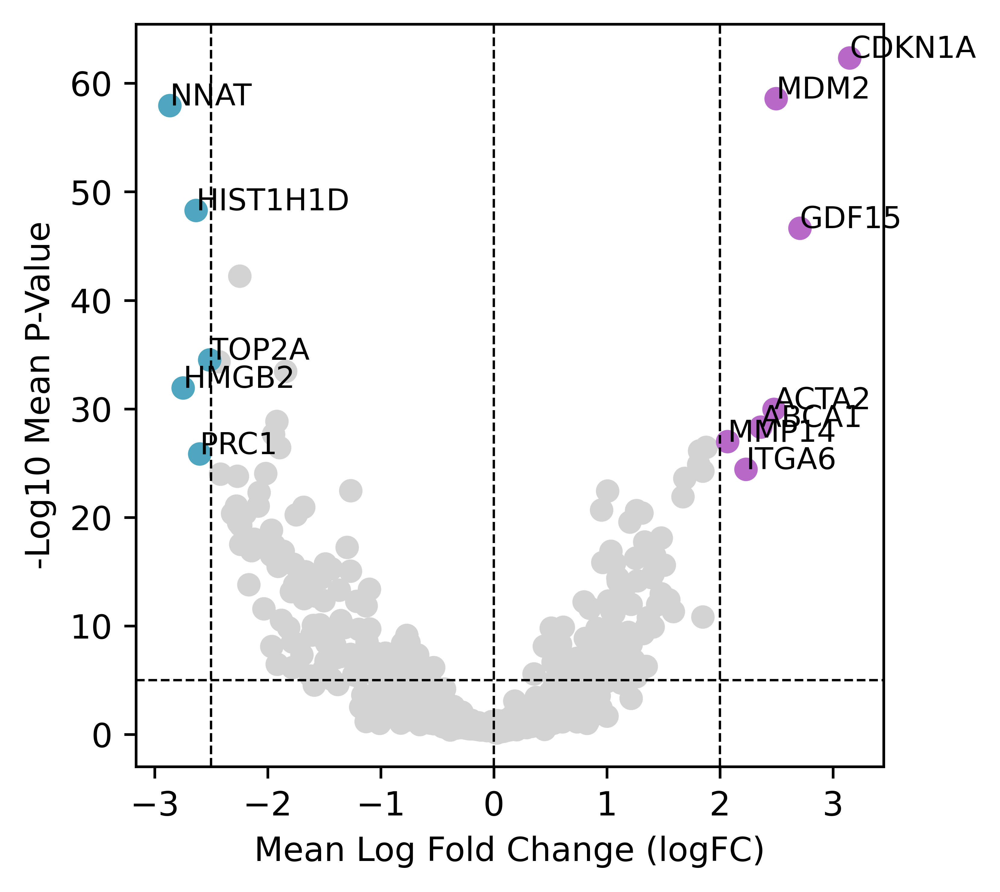

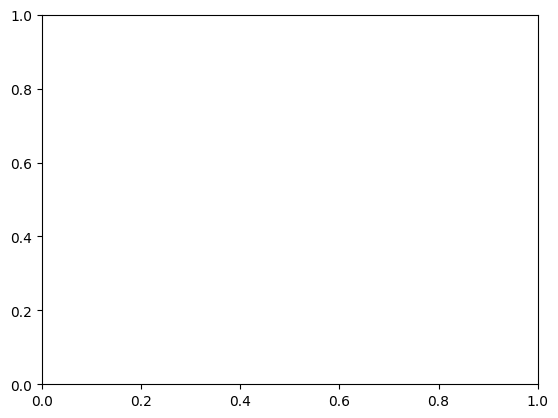

In [118]:
# Plotting
plt.figure(figsize=(4,4),dpi=800)

# Scatter plot for mean p-values and logFC
plt.scatter(deg_combined['logFC'], -np.log10(deg_combined['pvals']), color='lightgrey')

# Highlight specific genes based on custom criteria (adjust thresholds if needed)
highlight_genes = deg_combined[(deg_combined['logFC'] > 2) & (deg_combined['pvals'] < 0.00001)]
for i, row in highlight_genes.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#b669c9')
    plt.text(row['logFC'], -np.log10(row['pvals']), row['Gene'], fontsize=9)
    
highlight_genes = deg_combined[(deg_combined['logFC'] < -2.5) & (deg_combined['pvals'] < 0.00001)]
for i, row in highlight_genes.iterrows():
    plt.scatter(row['logFC'], -np.log10(row['pvals']), color='#4ea7bf')
    plt.text(row['logFC'], -np.log10(row['pvals']), row['Gene'], fontsize=9)

# Label the axes
plt.xlabel('Mean Log Fold Change (logFC)')
plt.ylabel('-Log10 Mean P-Value')

# Add dashed lines for specific thresholds

plt.axvline(x=2, color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=-2.5, color='black', linestyle='--', linewidth=0.7)
plt.axhline(y=-np.log10(0.00001), color='black', linestyle='--', linewidth=0.7)
plt.axvline(x=0, color='black', linestyle='--', linewidth=0.7)
# Label the axes
plt.xlabel('Mean Log Fold Change (logFC)')
plt.ylabel('-Log10 Mean P-Value')

# Add gridlines
plt.grid(False)

# Display the plot
plt.show()
# Add gridlines
plt.grid(False)

# Display the plot
plt.show()

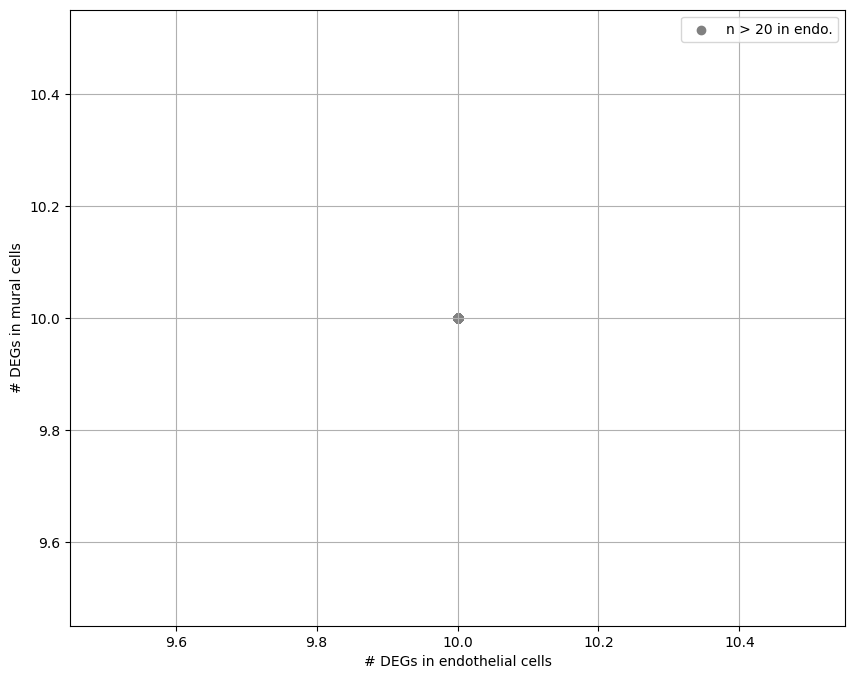

In [24]:
# Count the occurrences of each gene in the endothelial and mural columns
deg_count = deg_combined.melt(id_vars='Gene', var_name='CellType', value_name='GeneName')
deg_count = deg_count.groupby(['GeneName', 'CellType']).size().unstack(fill_value=0).reset_index()

# Rename the columns for clarity
deg_count.columns = ['Gene', 'DEGs_in_Endothelial', 'DEGs_in_Mural']

# Plotting
plt.figure(figsize=(10, 8))

# Scatter plot for DEGs in endothelial and mural cells
plt.scatter(deg_count['DEGs_in_Endothelial'], deg_count['DEGs_in_Mural'], color='grey')

# Highlight specific genes based on your criteria
for i, row in deg_count.iterrows():
    if row['DEGs_in_Endothelial'] > 20 and row['DEGs_in_Mural'] > 30:
        plt.scatter(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], color='orange')
        plt.text(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], row['Gene'], fontsize=9)
    elif row['DEGs_in_Endothelial'] > 20:
        plt.scatter(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], color='red')
        plt.text(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], row['Gene'], fontsize=9)
    elif row['DEGs_in_Mural'] > 30:
        plt.scatter(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], color='yellow')
        plt.text(row['DEGs_in_Endothelial'], row['DEGs_in_Mural'], row['Gene'], fontsize=9)

# Label the axes
plt.xlabel('# DEGs in endothelial cells')
plt.ylabel('# DEGs in mural cells')

# Add a legend
plt.legend(['n > 20 in endo.', 'n > 30 in mural', 'Both'])

# Add gridlines
plt.grid(True)

In [222]:

def get_rank(df_, gene):
    df_rank = []
    for i in df_.columns:  
        df_rank.append(list(df_[i].values).index(gene))
    return df_rank

def plot_rank_up(gene):
    temp_ec = get_rank(deg_up_df_EC, gene)
    temp_fb = get_rank(deg_up_df_FB, gene)
    temp_mural = get_rank(deg_up_df_mural, gene)    
    time_ = [-1, 1, 3, 5, 7, 9, 11, 13, 15, 17]
    
    fig, ax = plt.subplots(1, 1, figsize=(4, 1.5), dpi=800)
    ax.plot(time_, temp_ec, marker='o', linestyle='-', color='#fa2616')  # Line plot with markers
    ax.plot(time_, temp_fb, marker='o', linestyle='-', color='#3145a8')  # Plot the data points with lines connecting them
    ax.plot(time_, temp_mural, marker='o', linestyle='-', color='#7fa349')  # Plot the data points with lines connecting them
    
    ax.set_title(gene)
    ax.set_xlabel('Day')
    ax.set_ylabel('Ranking')
    ax.invert_yaxis()
    ax.set_xticks(time_)  # Ensure all time points are displayed on the x-axis

    plt.show()
    

def plot_rank_down(gene):
    temp_ec = get_rank(deg_down_df_EC, gene)
    temp_fb = get_rank(deg_down_df_FB, gene)
    temp_mural = get_rank(deg_down_df_mural, gene)    
    time_ = [-1, 1, 3, 5, 7, 9, 11, 13, 15, 17]
    
    fig, ax = plt.subplots(1, 1, figsize=(4, 1.5), dpi=800)
    ax.plot(time_, temp_ec, marker='o', linestyle='-', color='#fa2616')  # Line plot with markers
    ax.plot(time_, temp_fb, marker='o', linestyle='-', color='#3145a8')  # Plot the data points with lines connecting them
    ax.plot(time_, temp_mural, marker='o', linestyle='-', color='#7fa349')  # Plot the data points with lines connecting them
    
    ax.set_title(gene)
    ax.set_xlabel('Day')
    ax.set_ylabel('Ranking')
    ax.invert_yaxis()
    ax.set_xticks(time_)  # Ensure all time points are displayed on the x-axis

    plt.show()

In [226]:
np.unique(deg_down_df_EC.head(3).values.flatten())

array(['AK4', 'ASPM', 'HIST1H1D', 'HMGB2', 'KIF11', 'L1TD1', 'LDHA',
       'MKI67', 'NNAT', 'PRC1'], dtype=object)

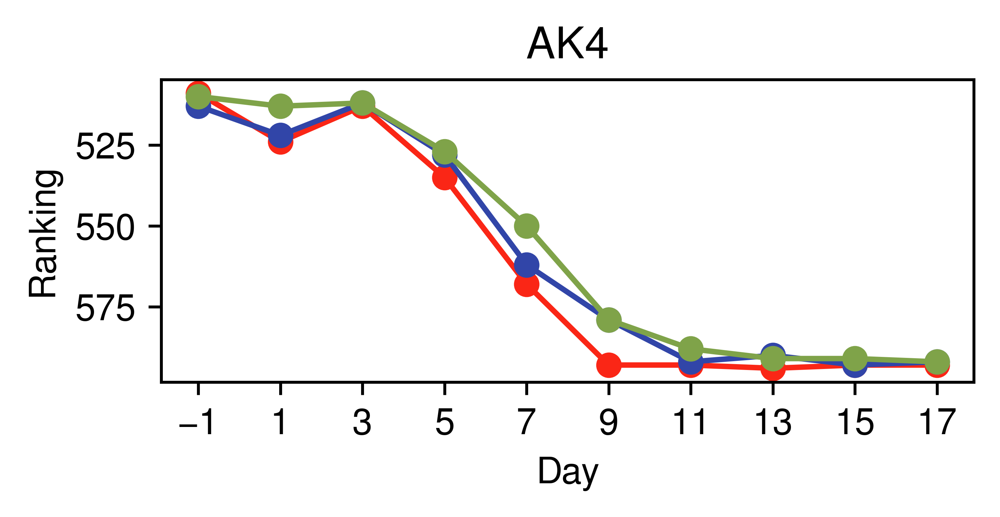

In [237]:
plot_rank_up('AK4')

In [447]:
deg_down_df_EC

,EC_day_-1.0,EC_day_1.0,EC_day_3.0,EC_day_5.0,EC_day_7.0,EC_day_9.0,EC_day_11.0,EC_day_13.0,EC_day_15.0,EC_day_17.0
0,KIF11,HMGB2,HMGB2,NNAT,NNAT,NNAT,NNAT,NNAT,NNAT,NNAT
1,HMGB2,KIF11,MKI67,HMGB2,HIST1H1D,HIST1H1D,HIST1H1D,AK4,HIST1H1D,L1TD1
2,ASPM,PRC1,PRC1,PRC1,PRC1,AK4,AK4,LDHA,AK4,AK4
3,PRC1,SPC25,KIF11,KIF11,HMGB2,LDHA,LDHA,HIST1H1D,L1TD1,HIST1H1D
4,SPC25,MKI67,HIST1H2AG,MKI67,HIST1H1B,PRC1,NDC80,L1TD1,LDHA,LDHA
...,...,...,...,...,...,...,...,...,...,...
591,MMP14,MMP14,ACTA2,ACTA2,ACTA2,ABCA1,PDGFA,MMP14,ACTA2,MGAT4C
592,MDM2,CDKN1A,GDF15,GDF15,GDF15,ACTA2,ACTA2,ACTA2,NDRG4,ACTA2
593,ABCA1,ITGA6,CDKN1A,ABCA1,ABCA1,GDF15,GDF15,GDF15,GDF15,GDF15
594,PRDM1,MDM2,ABCA1,CDKN1A,MDM2,MDM2,MDM2,MDM2,MDM2,MDM2


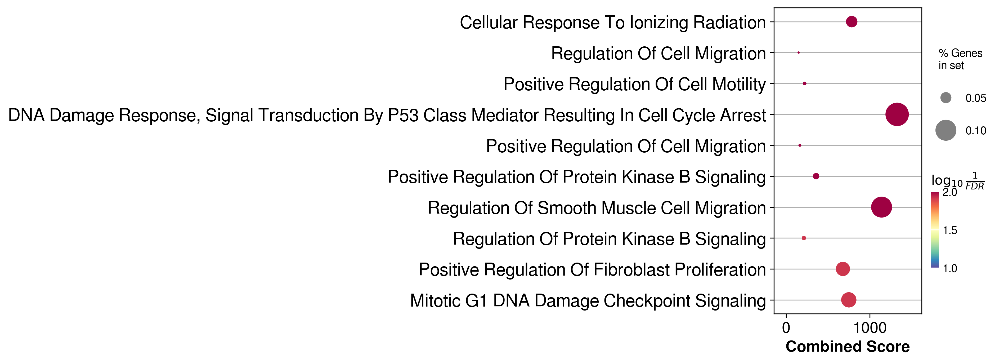

In [375]:

import gseapy as gp
enr_up = gp.enrichr(list(deg_up_df_EC.iloc[:20,9:10].values.flatten()),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=30)
plt.show()

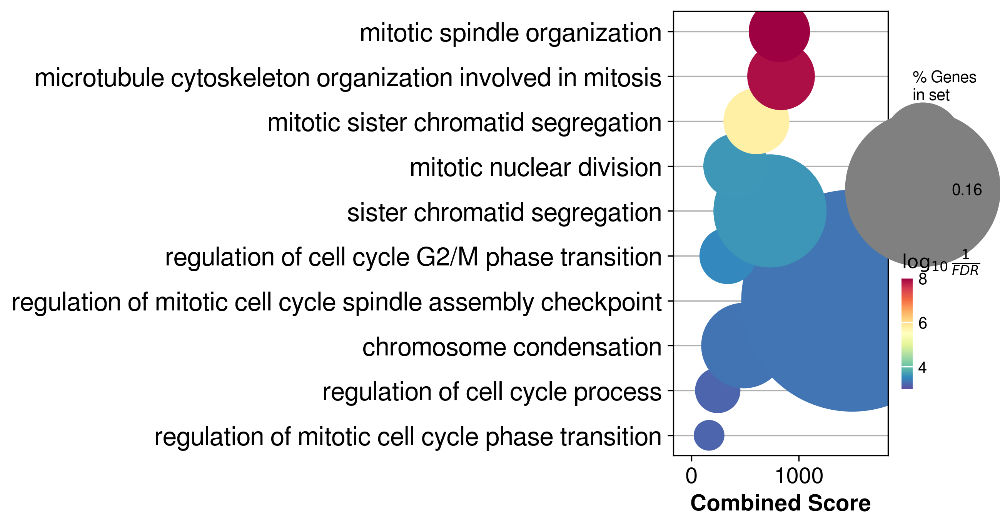

In [467]:
import gseapy as gp
enr_up = gp.enrichr(list(deg_down_df_FB.iloc[:30,1:10].values.flatten()),
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=100)
plt.show()

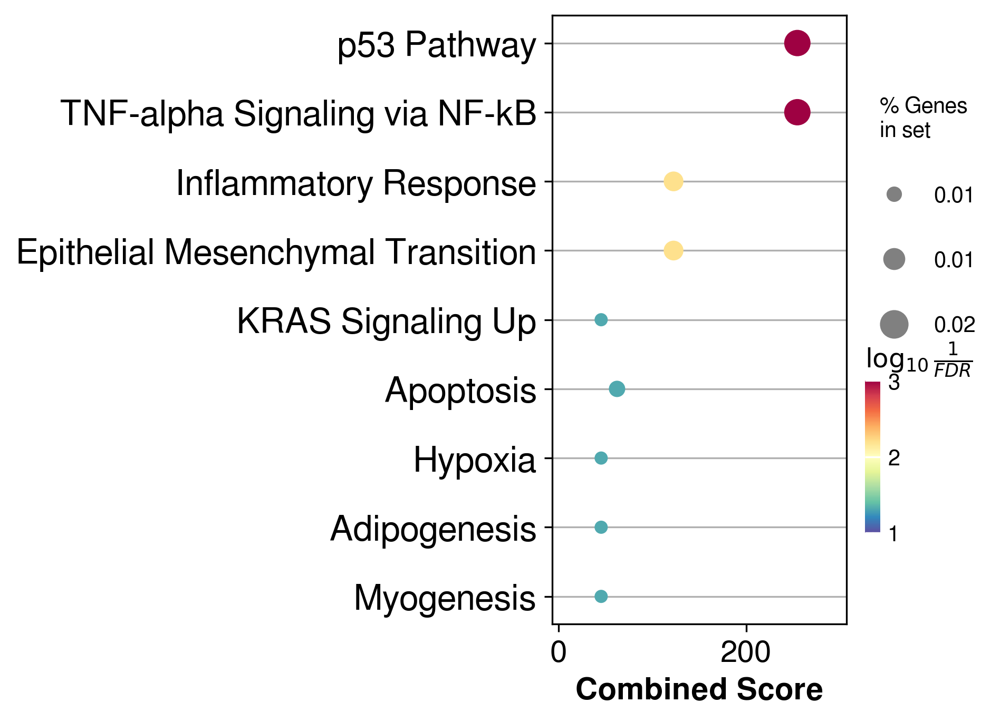

In [372]:
import gseapy as gp
enr_up = gp.enrichr(list(deg_up_df_EC.iloc[:20,9:10].values.flatten()),
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=100)
plt.show()

In [373]:
enr_up.res2d

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,4/200,0.000041,0.000539,0,0,25.234694,254.632919,ABCA1;CDKN1A;TUBB2A;GADD45A
1,MSigDB_Hallmark_2020,p53 Pathway,4/200,0.000041,0.000539,0,0,25.234694,254.632919,CDKN1A;GADD45A;MDM2;PDGFA
2,MSigDB_Hallmark_2020,Epithelial Mesenchymal Transition,3/200,0.000991,0.006438,0,0,17.721409,122.583777,ACTA2;MMP14;GADD45A
3,MSigDB_Hallmark_2020,Inflammatory Response,3/200,0.000991,0.006438,0,0,17.721409,122.583777,ABCA1;CDKN1A;MMP14
4,MSigDB_Hallmark_2020,Apoptosis,2/161,0.011126,0.048519,0,0,13.851153,62.309146,CDKN1A;GADD45A
5,MSigDB_Hallmark_2020,Hypoxia,2/200,0.016795,0.048519,0,0,11.101010,45.366284,CDKN1A;MT1E
6,MSigDB_Hallmark_2020,Adipogenesis,2/200,0.016795,0.048519,0,0,11.101010,45.366284,ABCA1;GADD45A
7,MSigDB_Hallmark_2020,Myogenesis,2/200,0.016795,0.048519,0,0,11.101010,45.366284,CDKN1A;CKB
8,MSigDB_Hallmark_2020,KRAS Signaling Up,2/200,0.016795,0.048519,0,0,11.101010,45.366284,PRDM1;ENG
9,MSigDB_Hallmark_2020,Angiogenesis,1/36,0.035407,0.092059,0,0,29.992481,100.199973,PDGFA


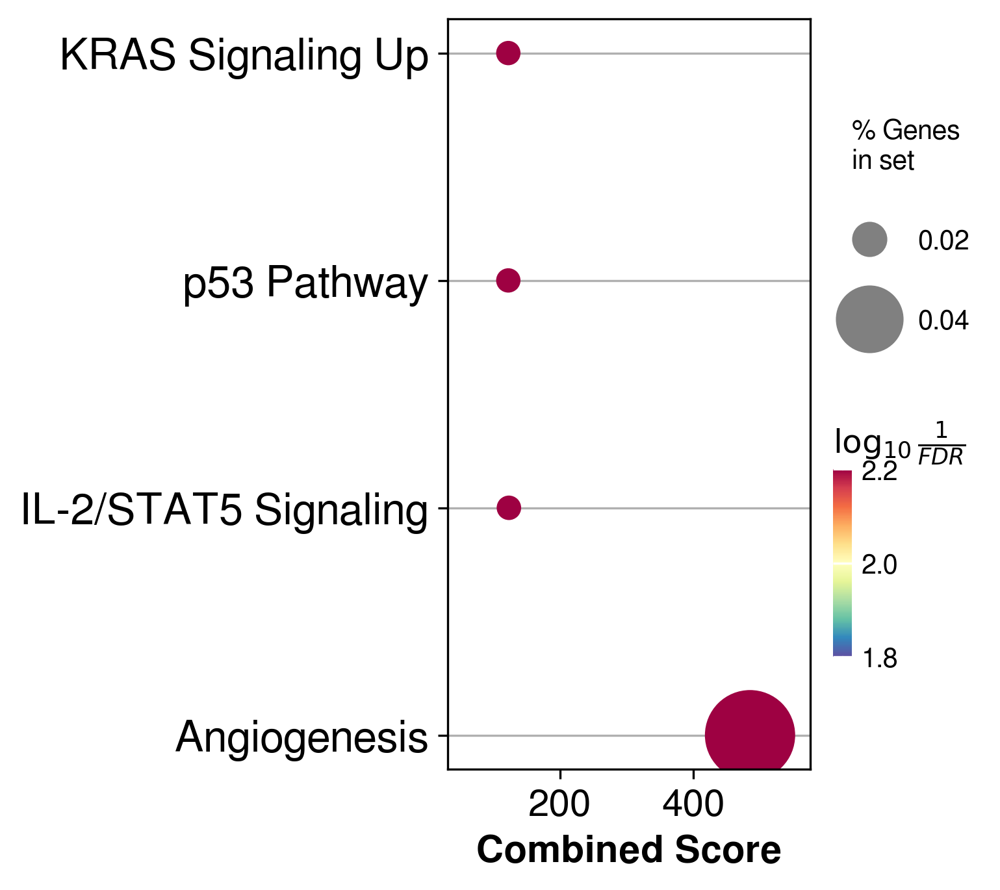

In [369]:
import gseapy as gp
enr_up = gp.enrichr(list(deg_up_df_FB.iloc[:20,9:10].values.flatten()),
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=100)
plt.show()

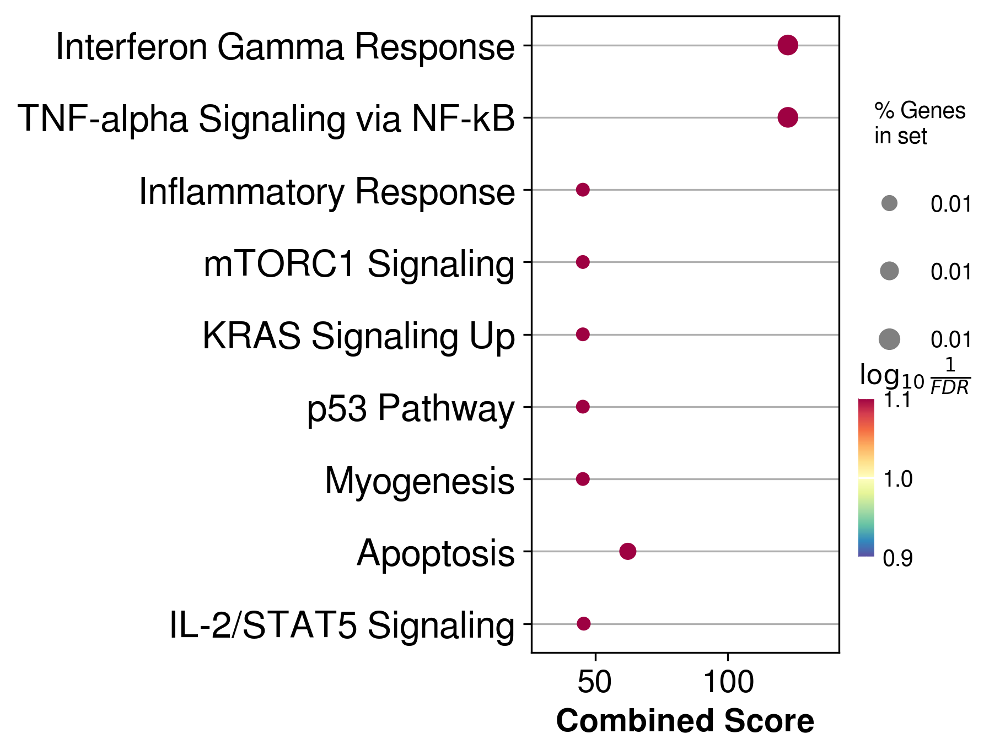

In [370]:
import gseapy as gp
enr_up = gp.enrichr(list(deg_up_df_mural.iloc[:20,9:10].values.flatten()),
                    gene_sets='MSigDB_Hallmark_2020',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
gp.dotplot(enr_up.res2d,
           figsize=(3,5),
           title="",
           cmap = plt.cm.Spectral_r,
           size=100)
plt.show()

In [441]:
def plot_bar_ontology(rad_gene_list):
    rad_gene_list = np.intersect1d(rad_gene_list,concated_anndata.var_names)
    concated_anndata.obs['rad_gene'] = concated_anndata[:,rad_gene_list].to_df().mean(axis=1)
    order = ['-1.0', '1.0', '3.0', '5.0', '7.0', '9.0', '11.0', '13.0', '15.0', '17.0']
    concated_anndata.obs['day'] = pd.Categorical(concated_anndata.obs['day'], categories=order, ordered=True, )


    pertb_true = concated_anndata[concated_anndata.obs['pertb'] == 'True'].obs[['rad_gene', 'day', 'type']].copy()
    pertb_false = concated_anndata[concated_anndata.obs['pertb'] == 'False'].obs[['rad_gene', 'day', 'type']].copy()

    # Ensure they have the same index for proper alignment
    pertb_true = pertb_true.sort_index()
    pertb_false = pertb_false.sort_index()

    # Compute the difference
    rad_gene_diff = pertb_true['rad_gene'].values - pertb_false['rad_gene'].values

    # Create a new DataFrame to store the difference
    concated_anndata_diff = pertb_true.copy()
    concated_anndata_diff['rad_gene_diff'] = rad_gene_diff

    # Ensure 'day' is categorical with the correct order
    order = ['-1.0', '1.0', '3.0', '5.0', '7.0', '9.0', '11.0', '13.0', '15.0', '17.0']
    concated_anndata_diff['day'] = pd.Categorical(concated_anndata_diff['day'], categories=order, ordered=True)
    hex_colors = [  '#fa2616','#ffc2c2','#3145a8','#99a9f7','#7fa349', 
                    '#c4d9a5',]
    custom_palette = {
        'EC': '#ffc2c2',
        'Fibroblast': '#99a9f7',
        'Mural': '#c4d9a5'
    }


    plt.subplots(1,1,figsize=(4,1),dpi=800)
    # Plot using seaborn's barplot
    ax=sns.barplot(
        data=concated_anndata_diff, 
        hue='type',  # Assuming 'type' column exists and is needed for the hue
        x='day', 
        y='rad_gene_diff',
        palette=custom_palette
    )
    # Remove the legend
    ax.legend_.remove()

    plt.xlabel('Day')
    plt.ylabel('')
    #plt.title('Gene Expression Difference Over Time')
    plt.show()

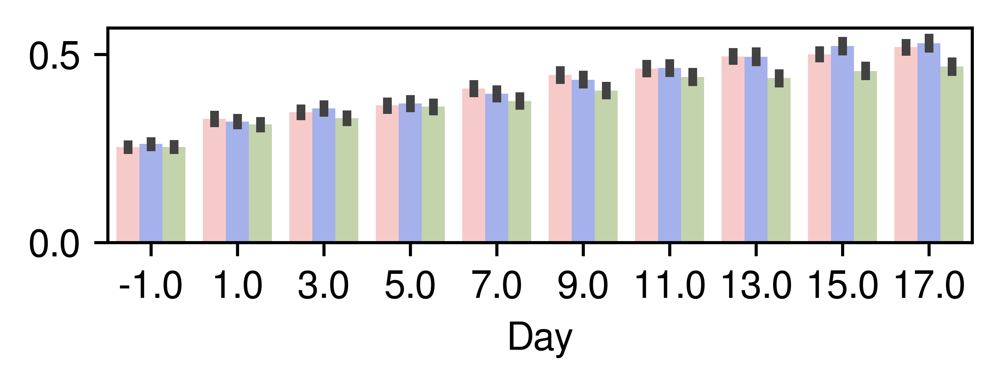

In [442]:
radiation_response = ["ATM","ATR","BABAM2","BARD1","BCL2L1","BLM","BRCA1","BRCA2","BRCC3","CCND2","CDKN1A","CHEK2","CLOCK","CRYAB","ECT2","EEF1D","EGR1","ELK1","FBXO4","FIGNL1","GADD45A","GATA3","GRB2","GTF2H5","H2AX","HRAS","HSF1","HUS1","IFI16","INO80","INTS7","ITGB6","KDM1A","KDM4D","LIG4","MAP3K20","MAPK14","MDM2","MIR21","NET1","NIPBL","NUCKS1","PRAP1","RAD1","RAD51","RAD51AP1","RAD9A","RAD9B","RHNO1","RHOB","RPL26","SFRP1","SFRP2","SIRT1","SNAI2","SPIDR","SWI5","TANK","TLK2","TMEM109","TNKS1BP1","TP53","TP53BP1","TREX1","TSPYL5","WRN","XRCC5","XRCC6","YAP1","ZMPSTE24"]
plot_bar_ontology(radiation_response)

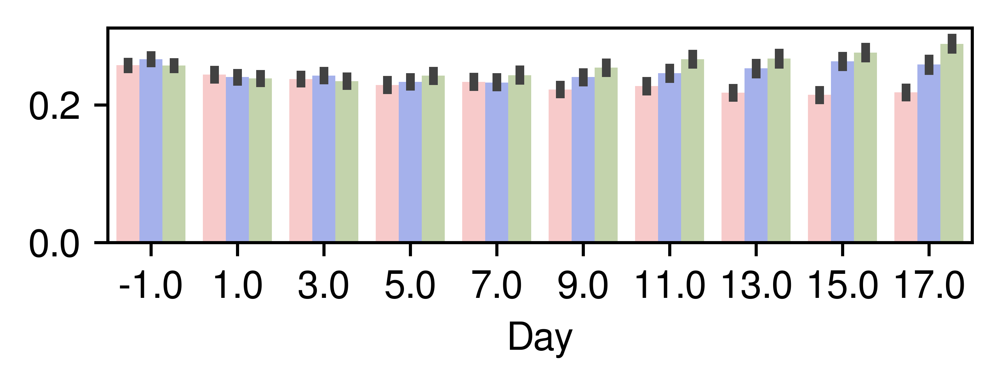

In [444]:
radiation_response = ["ADD1","AIFM3","ANKH","ANXA1","APP","ATF3","AVPR1A","BAX","BCAP31","BCL10","BCL2L1","BCL2L10","BCL2L11","BCL2L2","BGN","BID","BIK","BIRC3","BMF","BMP2","BNIP3L","BRCA1","BTG2","BTG3","CASP1","CASP2","CASP3","CASP4","CASP6","CASP7","CASP8","CASP9","CAV1","CCNA1","CCND1","CCND2","CD14","CD2","CD38","CD44","CD69","CDC25B","CDK2","CDKN1A","CDKN1B","CFLAR","CLU","CREBBP","CTH","CTNNB1","CYLD","DAP","DAP3","DCN","DDIT3","DFFA","DIABLO","DNAJA1","DNAJC3","DNM1L","DPYD","EBP","EGR3","EMP1","ENO2","ERBB2","ERBB3","EREG","ETF1","F2","F2R","FAS","FASLG","FDXR","FEZ1","GADD45A","GADD45B","GCH1","GNA15","GPX1","GPX3","GPX4","GSN","GSR","GSTM1","GUCY2D","H1-0","HGF","HMGB2","HMOX1","HSPB1","IER3","IFITM3","IFNB1","IFNGR1","IGF2R","IGFBP6","IL18","IL1A","IL1B","IL6","IRF1","ISG20","JUN","KRT18","LEF1","LGALS3","LMNA","LUM","MADD","MCL1","MGMT","MMP2","NEDD9","NEFH","PAK1","PDCD4","PDGFRB","PEA15","PLAT","PLCB2","PLPPR4","PMAIP1","PPP2R5B","PPP3R1","PPT1","PRF1","PSEN1","PSEN2","PTK2","RARA","RELA","RETSAT","RHOB","RHOT2","RNASEL","ROCK1","SAT1","SATB1","SC5D","SLC20A1","SMAD7","SOD1","SOD2","SPTAN1","SQSTM1","TAP1","TGFB2","TGFBR3","TIMP1","TIMP2","TIMP3","TNF","TNFRSF12A","TNFSF10","TOP2A","TSPO","TXNIP","VDAC2","WEE1","XIAP"]
plot_bar_ontology(radiation_response)

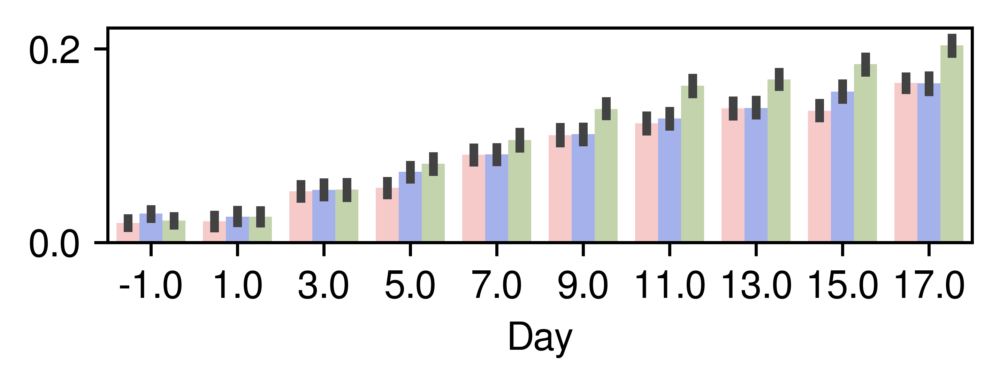

In [468]:
radiation_response = ["ABCC1","ABCD1","ABL1","ADPRS","AGAP3","AIF1","AIFM1","AIFM2","AKT1","ALDH3B1","ALOX5","ANKRD2","ANKZF1","ANXA1","APOA4","AQP1","ARL6IP5","ARNT","ATF2","ATF4","ATM","ATP13A2","ATP2A2","ATP7A","AXL","BECN1","BMAL1","BMP7","BNIP3","BRF2","BTK","CAMKK2","CAT","CBX8","CCS","CD36","CDK1","CHCHD2","CHUK","CPEB2","CRYGD","CYP1B1","DAPK1","DDR2","DHFR","DHFRP1","DHRS2","ECT2","EDN1","EDNRA","EGFR","EIF2S1","EPAS1","ERCC6L2","ERMP1","ERN1","ETV5","EZH2","FABP1","FANCC","FANCD2","FBLN5","FER","FOS","FOXO1","FOXO3","FOXP1","FUT8","FXN","FYN","G6PD","GAS5","GCH1","GJB2","GLRX2","GPR37","GPR37L1","GPX1","GPX5","GPX7","GPX8","GSR","H19","HDAC2","HDAC6","HGF","HIF1A","HM13","HMOX1","HSF1","HSPA1A","HSPA1B","HTRA2","IL18BP","IL18RAP","IL6","JUN","KAT2B","KDM6B","KEAP1","KLF2","LONP1","LRRK2","MAP1LC3A","MAP2K4","MAP3K5","MAPK1","MAPK13","MAPK3","MAPK7","MAPK8","MAPK9","MAPKAP1","MAPT","MDM2","MEAK7","MET","MGAT3","MGST1","MIR103A1","MIR107","MIR132","MIR133A1","MIR135A1","MIR17","MIR21","MIR34A","MIR675","MIR92A1","MIRLET7B","MMP2","MMP3","MMP9","MPO","MPV17","MPV17L","MPV17L2","MSRA","MT3","MYB","NAGLU","NCF1","NCOA7","NET1","NFE2L2","NME8","NOS3","NQO1","NR4A2","NUDT2","OSER1","OXR1","PARK7","PARP1","PAWR","PAX2","PCGF2","PCNA","PDCD10","PDGFD","PDGFRA","PDK2","PENK","PEX10","PEX12","PEX13","PEX14","PEX2","PEX5","PINK1","PJVK","PKD2","PLA2R1","PLEKHA1","PNPLA8","PNPT1","PPARGC1A","PPARGC1B","PPIA","PPIF","PRDX1","PRDX2","PRDX3","PRDX5","PRKAA1","PRKAA2","PRKCD","PRKD1","PRKN","PRKRA","PRR5L","PTPRK","PXN","PYCR1","PYCR2","PYROXD1","RACK1","RAD52","RBM11","RELA","RHOB","RIPK1","RIPK3","ROMO1","RPS3","RWDD1","SELENON","SELENOS","SESN2","SETX","SIN3A","SIRPA","SIRT1","SIRT2","SLC1A1","SLC25A14","SLC25A24","SLC4A11","SLC7A11","SMPD3","SNCA","SOD1","SOD2","SOD3","SPHK1","SQSTM1","SRC","SRXN1","STAT6","STAU1","STAU2","STK25","STX2","STX4","SUMO4","TBC1D24","TMEM161A","TMIGD1","TNFAIP3","TOP2B","TP53","TP53INP1","TPM1","TRAP1","TREX1","TRPA1","TRPM2","TXN","UCP1","VKORC1L1","VRK2","WNT16","ZC3H12A","ZFAND1","ZNF277","ZNF580"]
plot_bar_ontology(radiation_response)

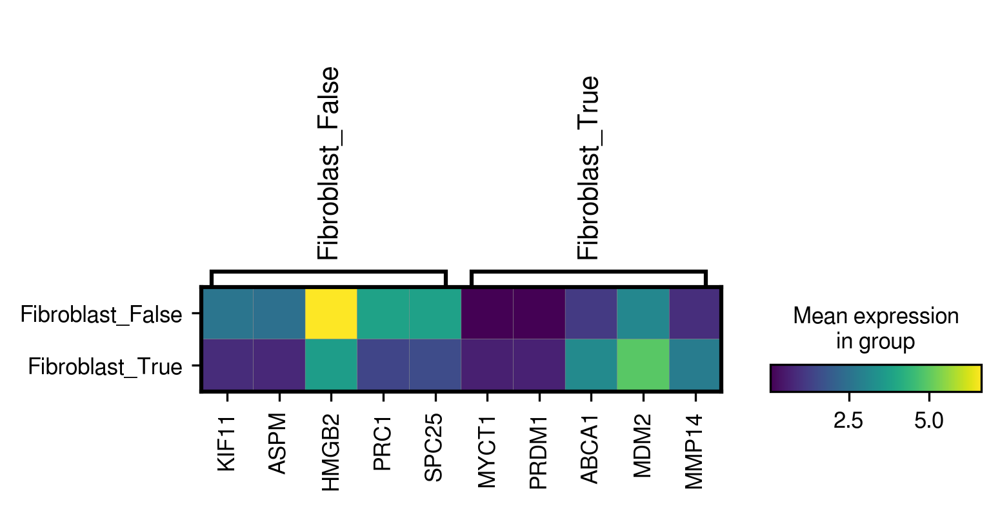

In [124]:
# Obtain cluster-specific differentially expressed genes
temp = concated_anndata[(concated_anndata.obs['type']=='Fibroblast') & (concated_anndata.obs['day']=='-1.0')].copy()
sc.tl.rank_genes_groups(temp, groupby="type_pertb", method="wilcoxon")
sc.pl.rank_genes_groups_matrixplot(temp, n_genes=5, groupby="type_pertb")

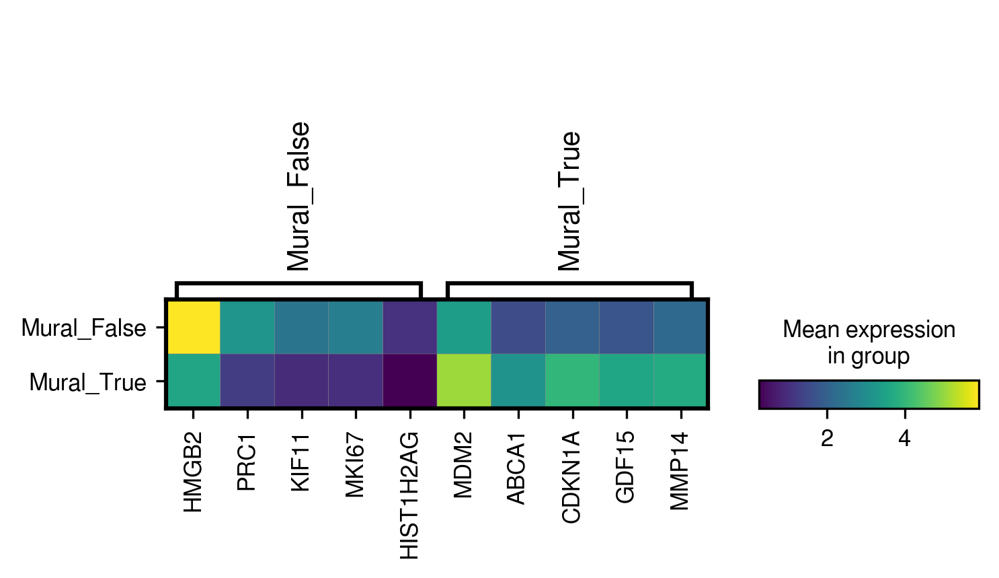

In [127]:
# Obtain cluster-specific differentially expressed genes
temp = concated_anndata[(concated_anndata.obs['type']=='Mural') & (concated_anndata.obs['day']=='3.0')].copy()
sc.tl.rank_genes_groups(temp, groupby="type_pertb", method="wilcoxon")
sc.pl.rank_genes_groups_matrixplot(temp, n_genes=5, groupby="type_pertb")

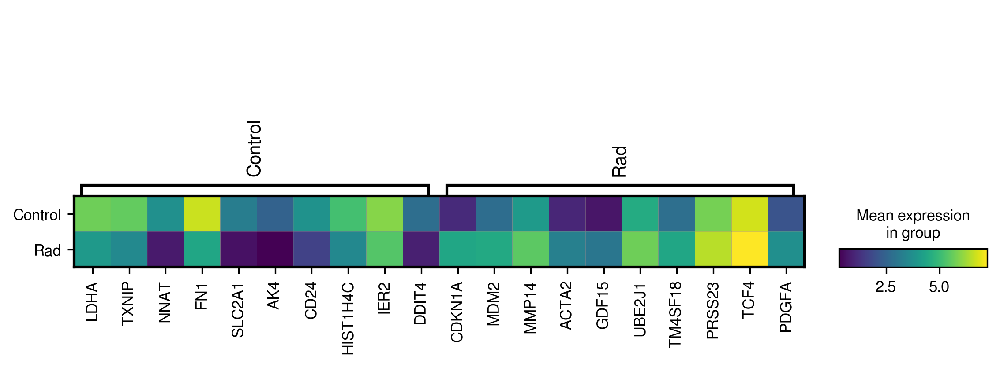

In [126]:
# Obtain cluster-specific differentially expressed genes
temp = adata_ctl_rad[(adata_ctl_rad.obs['Major_type']=='EC')].copy()
sc.tl.rank_genes_groups(temp, groupby="group_new", method="wilcoxon")
sc.pl.rank_genes_groups_matrixplot(temp, n_genes=10, groupby="group_new")

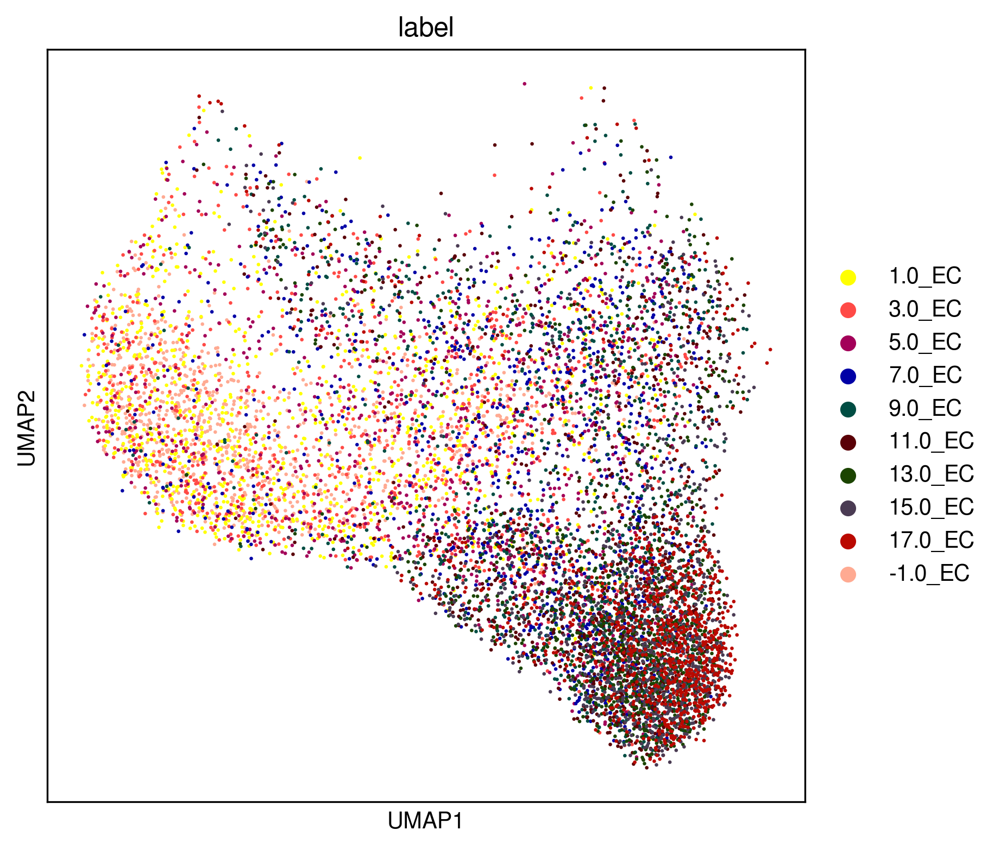

In [205]:
sc.pl.umap(pred_scVO_anndata[pred_scVO_anndata.obs['type']=='EC'],color = 'label',size=10)

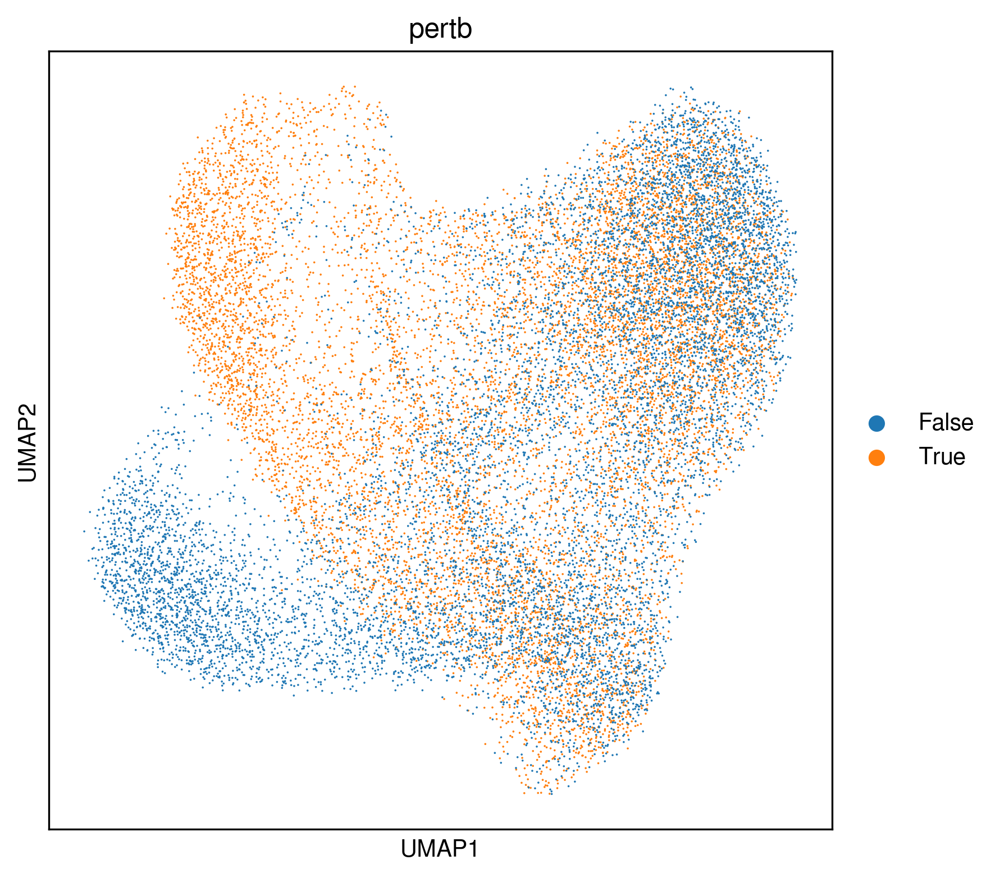

In [239]:
test = concated_anndata[concated_anndata.obs['type']=='EC']
sc.tl.pca(test, svd_solver='arpack')
sc.pp.neighbors(test, n_neighbors=50, n_pcs=50)
sc.tl.umap(test,min_dist=0.8)
sc.pl.umap(test,color = 'pertb',size=10)

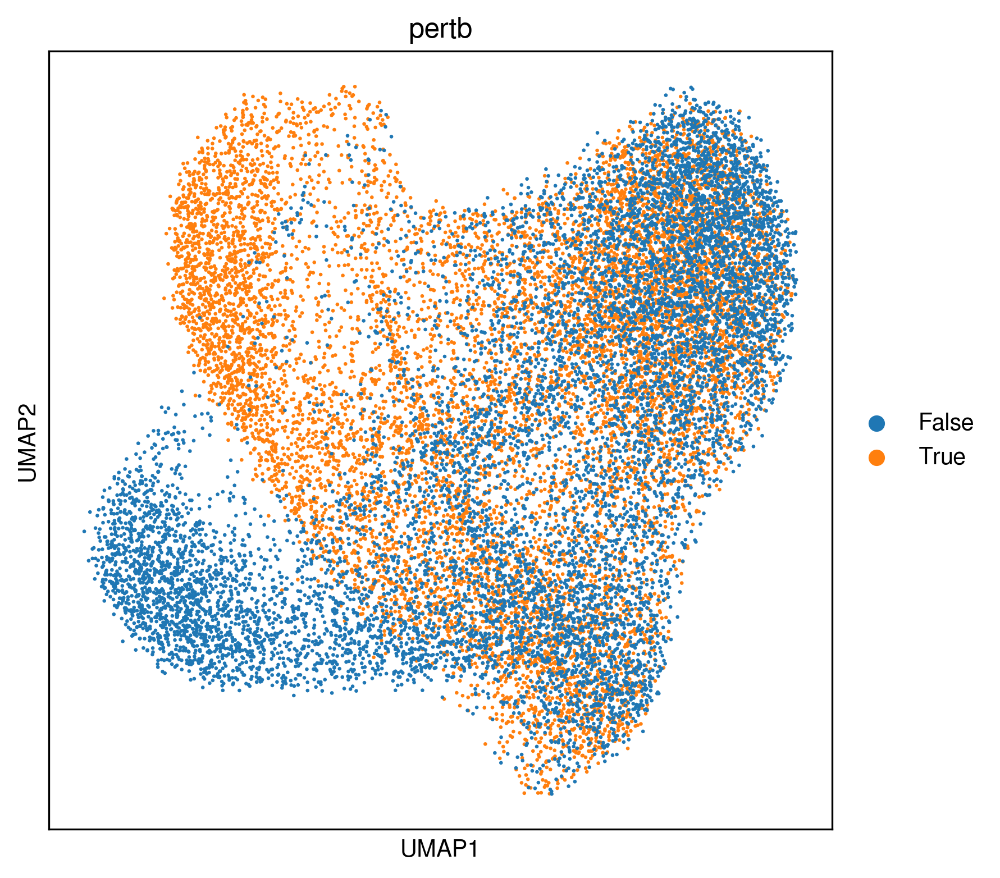

In [240]:
sc.pl.umap(test,color = 'pertb',size=10)